In [2]:
# packages
import pandas as pd
import numpy as np

from claspy.segmentation import BinaryClaSPSegmentation

import ruptures as rpt

import stumpy
from aeon.segmentation import find_dominant_window_sizes

from aeon.segmentation import GreedyGaussianSegmenter

from aeon.segmentation import InformationGainSegmenter

from aeon.anomaly_detection import STRAY

from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, make_scorer,mean_squared_error
from ruptures.metrics import precision_recall
import matplotlib.pyplot as plt
#from aeon.visualisation import plot_series_with_change_points, plot_series_with_profiles
import seaborn as sns

sns.set_theme()
sns.set_color_codes()

from claspy.tests.evaluation import f_measure,covering

In [3]:
def f1scoremargin(ground_truth, predictions, tolerance):
    """
    Calcola l'F1 score con una finestra di tolleranza sui change points.
    
    :param ground_truth: Lista o array di change points reali
    :param predictions: Lista o array di change points predetti
    :param tolerance: La tolleranza temporale (numero di unità temporali)
    :return: precision, recall, f1-score
    """
    ground_truth = np.array(ground_truth)
    predictions = np.array(predictions)
    
    # Vettori per tracciare quali punti sono stati già associati
    matched_ground_truth = np.zeros(len(ground_truth), dtype=bool)
    matched_predictions = np.zeros(len(predictions), dtype=bool)

    mgt={key: False for key in ground_truth}
    mcp={key: False for key in predictions}
    #print(f'gt:{len(ground_truth)} - cp:{len(predictions)}')
    # True Positives (TP)
    tp = 0
    for i, gt_point in enumerate(ground_truth):
        for j, pred_point in enumerate(predictions):
            if not matched_predictions[j] and abs(gt_point - pred_point) <= tolerance:
                tp += 1
                matched_ground_truth[i] = True
                matched_predictions[j] = True

                mgt[gt_point] = True
                mcp[pred_point] = True
                break
            
    
    # False Positives (FP) - predizioni non corrispondenti a nessun ground truth entro la tolleranza
    fp = np.sum(~matched_predictions)
    
    # False Negatives (FN) - punti del ground truth non corrispondenti a nessuna predizione entro la tolleranza
    fn = np.sum(~matched_ground_truth)
    #print(f'tp:{tp} - fp:{fp} - fn:{fn}')
    #print(mgt)
    #print(mcp)
    # Calcolo di precision, recall e F1-score
    precision = tp / (tp + fp) if (tp + fp) > 0 else 0
    recall = tp / (tp + fn) if (tp + fn) > 0 else 0
    f1 = 2 * (precision * recall) / (precision + recall) if (precision + recall) > 0 else 0
    
    return precision, recall, f1

In [4]:
# Questi sono tutte le features estratte
# kineticglobal,kineticchest,directnesshead,density,leftwristke,rightwristke,leftankleke,rightankleke,headke,posturaltension

# Queste sono le feature che utilizzeremo
# kineticglobal, density, leftwirstke, rightwristke, leftankleke, rightankleke, headke, posturaltension
# che corrispondono
# 2,4,5,6,7,8,9,10,11
# Questa funzione legge il file di input e restituisce un dataframe con i dati preprocessati
def ReadAndPreProcess(inputDataRaw):
    # lettura
    df=pd.read_csv(inputDataRaw,sep=' ', header=None)
    df.drop(0, axis=1)
    df["som"]=df.sum(axis=1)
    ## preprocessing

    # dealing NaN values
    #-serafino ha usato forward fill, backward fill, linear interpolation
    #-ricordo che serafino aveva gia utilizzato sta cosa sui dati grezzi non sulle feature ma sui dati prefeature percio dovrebbe essere gia apposto

    # downsampling
    #-sono a 100ms, non sò se devo scendere a 50ms. da decidere
    #-non lo faccio xk non mi interessa se va piu lento, guarda su notion per ulteriori informazioni

    # low pass filter
    #-Skogstad and colleagues (2013) e https://stackoverflow.com/questions/25191620/creating-lowpass-filter-in-scipy-understanding-methods-and-units
    #-implementare dopo

    # remove outliers
    #-utilizzare hampel filter

    # stretch
    #-forse devo stretcharlo come ho fatto precedentemente
    #-anche se nel codice precedente ho stretchato solo il groundtruth

    # ritorno un oggetto dataframe dopo che è stato lavorato, ottenendo un prodotto lavorato
    return df


In [5]:
# questa funzione ritorna un dataframe del groundtruth che viene usato specificatamente per visualizzare il gt
# è soggetto a un preprocessing dei dati siccome l'ultimo groundtruth è dove termina il ts del gt
# di conseguenza per farlo corrispondere, bisogna stretcharlo
# ma ricordo di aver rifatti i dati nuovi per generare un groundtruth a fine ts, da controllare cosi che non serve stretcharlo?
def LoadingGroundTruth(df,gtraw):
    gt=pd.read_csv(gtraw,sep=' ', header=None)
    gt=gt.iloc[:,0].values
    #stretching dei dati se necessario per farlo corrispondere alla ts dei dati
    stretch_gt = np.array([])
    for idx,i in enumerate(gt):
        relpos = len(df)*i/gt[-1]
        stretch_gt = np.append(stretch_gt,relpos)

    # eliminiamo l'ultimo elemento che è stato annotato solo per delimitare la lunghezza della gt simile alla ts
    return stretch_gt[:-1]

In [6]:
# utilizzo CLASP 
# prende come parametro un dataframe e restituisce il clasp score
# gt e known vengono usati per usare il numero vero di cp se uguale a 1 sennò si cerca di predirlo se il modello lo permette
def GetClasp(df,gt,known, **kwargs):
    
    result=np.array([])
    eachresult = []
    eachclasp=[]
    for idx,i in enumerate([2,4,5,6,7,8,9,10,11]):
      
        ts=df.iloc[:,i]
        clasp = BinaryClaSPSegmentation(**kwargs)
        found_cps = clasp.fit_predict(ts.values)    

        # c'è un bug con binseg dove un cp è oltre la lunghezza del ts
        # faccio un loop e se eccede cambio il valore con la len(tf)-1
        for i in range(0,len(found_cps)):
            if found_cps[i] >= len(ts):
                found_cps[i] = len(ts)-1

        # per ogni array di cp di ogni singola feature
        # li unisco in un unico array. in pratica faccio un OR di tutti i cp
        result = np.sort(np.append(result,found_cps).flatten())
        result = np.unique(result)
        eachresult.append(found_cps)
        eachclasp.append(clasp)
        
        

        
    return result, eachresult, eachclasp
        
    


In [7]:
# calcola i vari scores dati il groundtruth e il prediction
# puo salvare il risultato su file per evitare di perderli
# prende come parametro nome del groundtruth, groundtruth, nome della timeseries e il prediction
def Evaluate(modelName,gtName, gt, tsName, cp, df, margin,msg, nomeFile):
    # creo dei array di lunghezza come la ts cosi possono fare il confronto
    # sia per il gt che per il pd
  
    cpnump = np.array(cp)
    gtnump = np.array(gt)

    cp_long = np.zeros(len(df)+1)
    cp_long[cpnump.astype(int)]=1

    gt_long = np.zeros(len(df)+1)
    gt_long[gtnump.astype(int)]=1

    # calcolo lo score 
    print(f'f1margin: {f1scoremargin(gt.astype(int),cp.astype(int),margin)}')
    precision,recall,f1=f1scoremargin(gt.astype(int),cp.astype(int),margin)
     #scrivo su file il risultato
    f = open("outputFile/ClaSPallresult", "a")
    f.write(nomeFile+"\n")
    f.write(msg+"\n")
    f.write("precision:"+str(precision)+" recall:"+str(recall)+" f1:"+str(f1)+" \n")
    f.write("\n")
    f.close()

In [8]:
def Plotclasp(eachclasp,gt,margin,eachcp,nomeFile):
    
    for idx,clasp in enumerate(eachclasp):
        clasp.plot(gt_cps=gt.astype(int), heading=f'f1margin: {f1scoremargin(gt.astype(int),eachcp[idx].astype(int),margin)} {nomeFile}', ts_name="suss", file_path="segmentation_example.png")


    
        for idx2,j in enumerate(gt.astype(int)):
            plt.fill_betweenx(np.array([0, 1]), j-margin, j+margin, color='green', alpha=0.3)


In [12]:
def PlotResult(df,gt,cp, nomeFile, margin):
    #da testare quando ho piu valori
    #clasp.plot(gt_cps=gt.astype(int), heading="Segmentation of different umpire cricket signals", ts_name="ACC", file_path="segmentation_example.png")

    plt.figure(figsize=(18,9))
    plt.plot(np.arange(len(df["som"].values)),df["som"].values,'blue',linewidth=0.5)
    for idx2,i in enumerate(gt.astype(int)):

            plt.axvline(x = i, color = 'green',linewidth=1) 
            
    for j in cp.tolist():
        plt.axvline(x = j, color = 'red',linewidth=1,linestyle="-.") 

    for idx2,k in enumerate(gt.astype(int)):
            plt.fill_betweenx(np.array([0, 1]), k-margin, k+margin, color='green', alpha=0.3)
    plt.xlabel(f'{nomeFile} {f1scoremargin(gt.astype(int),cp.astype(int),margin)}')



In [13]:
#questi sono i dataset comprendente le timeseries e il groundtruth
timeseries=[#"in\cora1_input.txt",
      #"in\cora4_input.txt",
    "in\cora1_input.txt",
      "in\cora4_input.txt",
      "in\cora5_input.txt",
      "in\cora14_input.txt",
      "in\cora14_input.txt",
      "in\marianne7_input.txt",
      "in\marianne8_input.txt",
      "in\marianne10_input.txt",
      "in\marianne18_input.txt",
      "in\marianne19_input.txt",
      "in\marianne24_input.txt",
      "in\marianne26_input.txt",
      "in\marianne41_input.txt",
      "in\marianne42_input.txt",
      "in\marianne43_input.txt",
      "in\marianne47_input.txt",
      "in\marianne48_input.txt",
      "in\marianne48_input.txt",
      "in\muriel18_input.txt",
      "in\muriel26_input.txt",
      "in\muriel27_input.txt",
      "in\muriel30_input.txt"

      ]
groundtruth=[#"gt\cora_gt_2019-08-08_t001_video01.txt",
         #"gt\cora_gt_2019-08-08_t004_video01.txt",
            "gt\cora_gt_2019-08-08_t001_video01.txt",
         "gt\cora_gt_2019-08-08_t004_video01.txt",
         "gt\cora5_gt.txt",
         "gt\cora_gt_2019-08-08_t014_video01.txt",
         "gt\marianne_gt_2016-03-22_t007_video01.txt",
         "gt\marianne_gt_2016-03-22_t008_video01.txt",
         "gt\marianne_gt_2016-03-22_t010_video01.txt",
         "gt\marianne_gt_2016-03-22_t018_video01.txt",
         "gt\marianne_gt_2016-03-22_t019_video01.txt",
         "gt\marianne_gt_2016-03-22_t024_video01.txt",
         "gt\marianne_gt_2016-03-22_t026_video01.txt",
         "gt\marianne_gt_2016-03-22_t041_video01.txt",
         "gt\marianne_gt_2016-03-22_t042_video01.txt",
         "gt\marianne_gt_2016-03-22_t043_video01.txt",
         "gt\marianne_gt_2016-03-22_t047_video01.txt",
         "gt\marianne_gt_2016-03-22_t048_video01.txt",
         "gt\marianne_gt_2016-03-22_t048_video01.txt",
         "gt\muriel_gt_2016-03-21_t014_video01.txt",
         "gt\muriel_gt_2016-03-21_t018_video01.txt",
         "gt\muriel_gt_2016-03-21_t026_video01.txt",
         "gt\muriel_gt_2016-03-21_t027_video01.txt",
         "gt\muriel_gt_2016-03-23_t029_video01.txt",
         "gt\muriel_gt_2016-03-23_t030_video01.txt",
         "gt\muriel_gt_2016-03-23_t030_video01.txt"
         ]



0
f1margin: (0.34615384615384615, 0.28125, 0.3103448275862069)
1
f1margin: (0.4444444444444444, 0.25, 0.32)
2
f1margin: (0.1728395061728395, 0.8235294117647058, 0.2857142857142857)
3
f1margin: (1.0, 0.04, 0.07692307692307693)
4
f1margin: (0.0, 0.0, 0)
5


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\scipy\stats\_stats_py.py:9205: RuntimeWarning: invalid value encountered in scalar divide
  z = (s - expected) / np.sqrt(n1*n2*(n1+n2+1)/12.0)


f1margin: (0.3333333333333333, 0.07407407407407407, 0.12121212121212122)
6
f1margin: (1.0, 0.07692307692307693, 0.14285714285714288)
7
f1margin: (1.0, 0.07692307692307693, 0.14285714285714288)
8
f1margin: (1.0, 0.044444444444444446, 0.0851063829787234)
9
f1margin: (0.3333333333333333, 0.045454545454545456, 0.08)
10
f1margin: (1.0, 0.047619047619047616, 0.0909090909090909)
11
f1margin: (0, 0.0, 0)
12
f1margin: (0.0, 0.0, 0)
13
f1margin: (1.0, 0.02564102564102564, 0.05)
14
f1margin: (0.21052631578947367, 0.23529411764705882, 0.2222222222222222)
15
f1margin: (0, 0.0, 0)
16
f1margin: (1.0, 0.058823529411764705, 0.1111111111111111)
17
f1margin: (1.0, 0.023255813953488372, 0.04545454545454545)
18
f1margin: (1.0, 0.08571428571428572, 0.15789473684210528)
19
f1margin: (0.0, 0.0, 0)
20


C:\Users\loluc\AppData\Local\Temp\ipykernel_18008\8351913.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(18,9))


f1margin: (1.0, 0.012658227848101266, 0.024999999999999998)
21
f1margin: (0.9090909090909091, 0.14925373134328357, 0.2564102564102564)


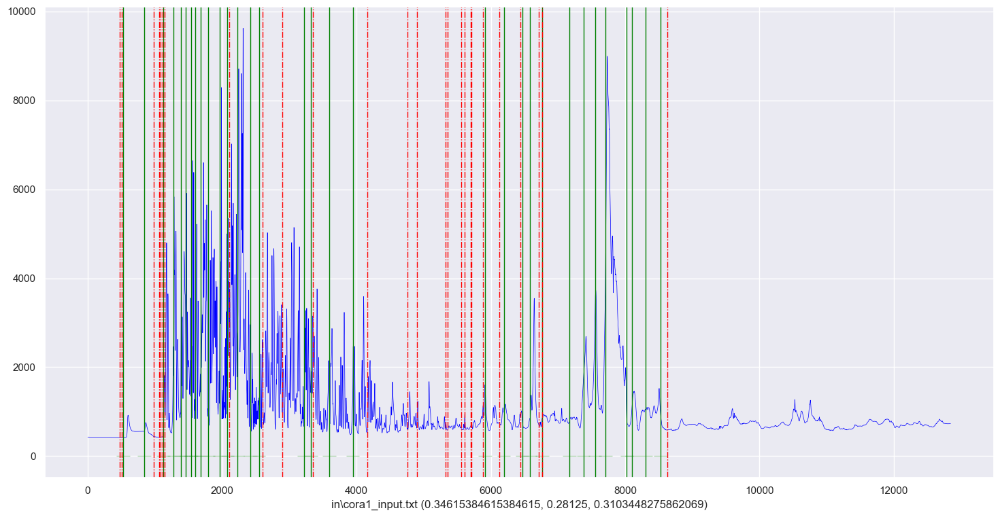

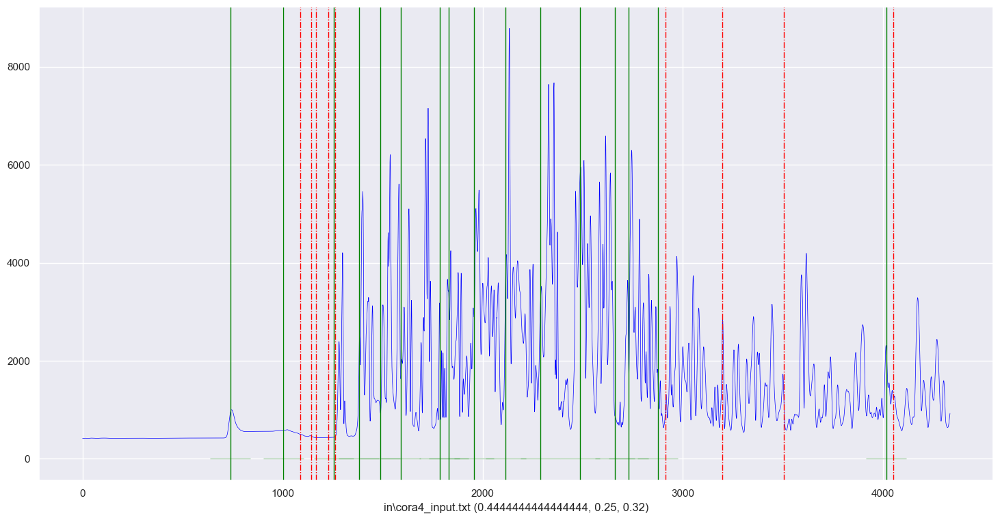

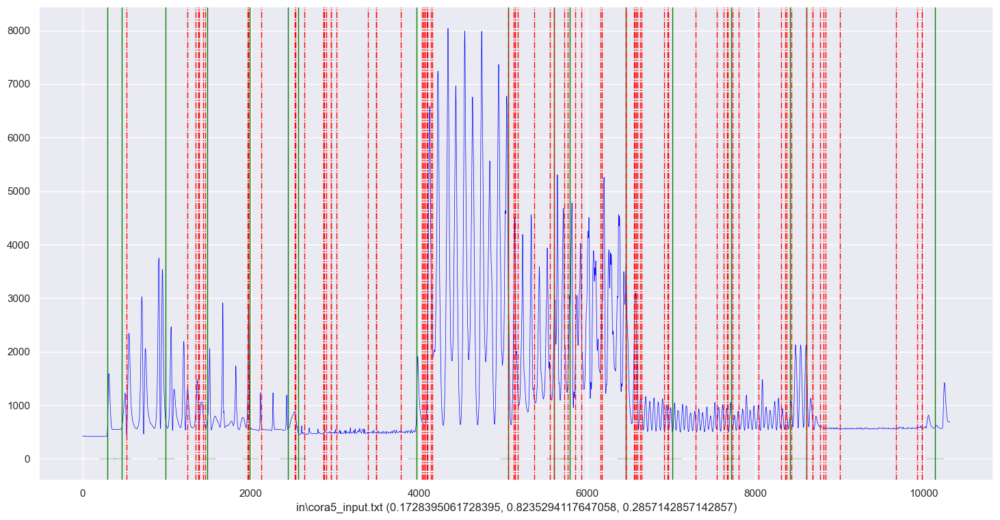

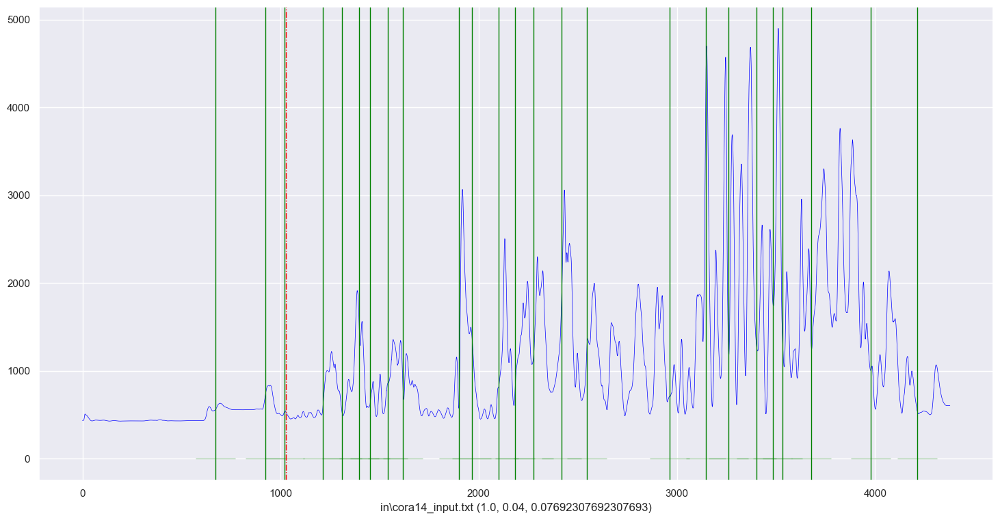

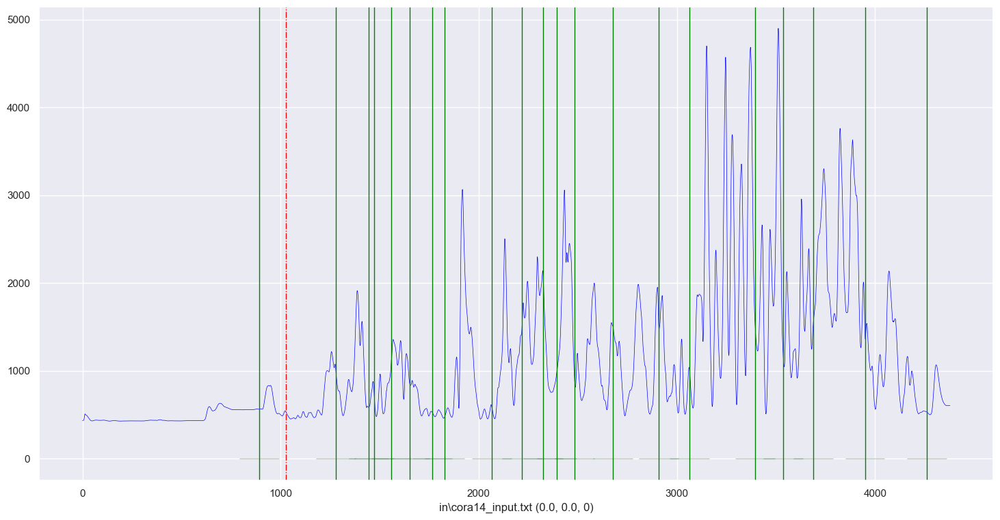

...

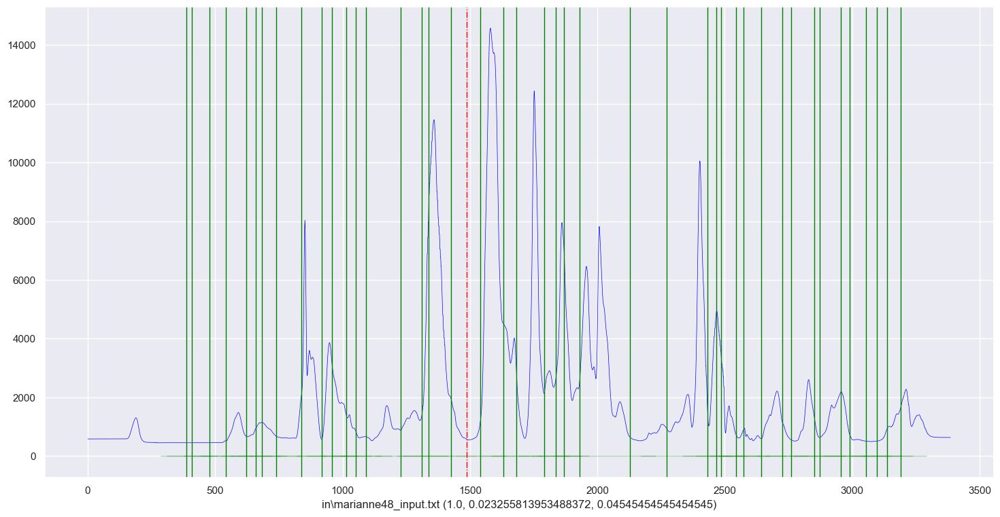

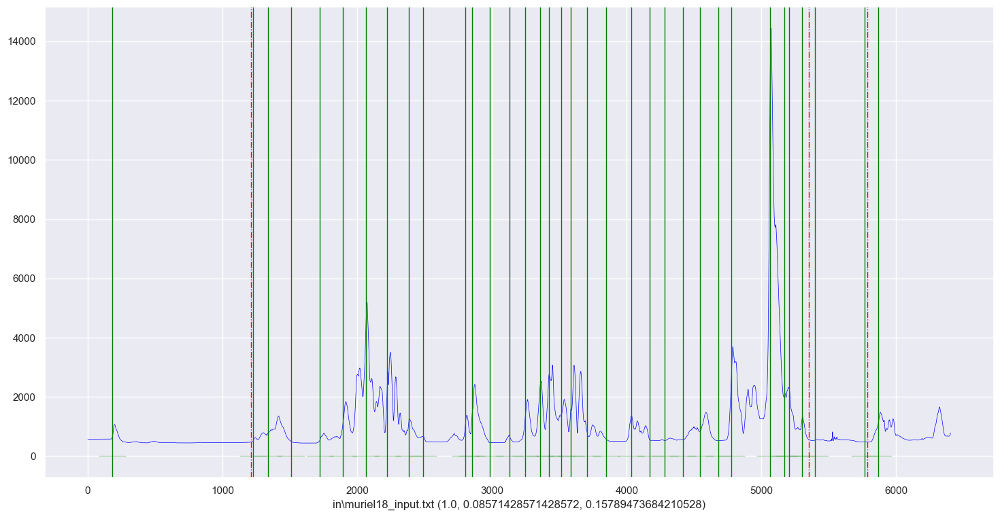

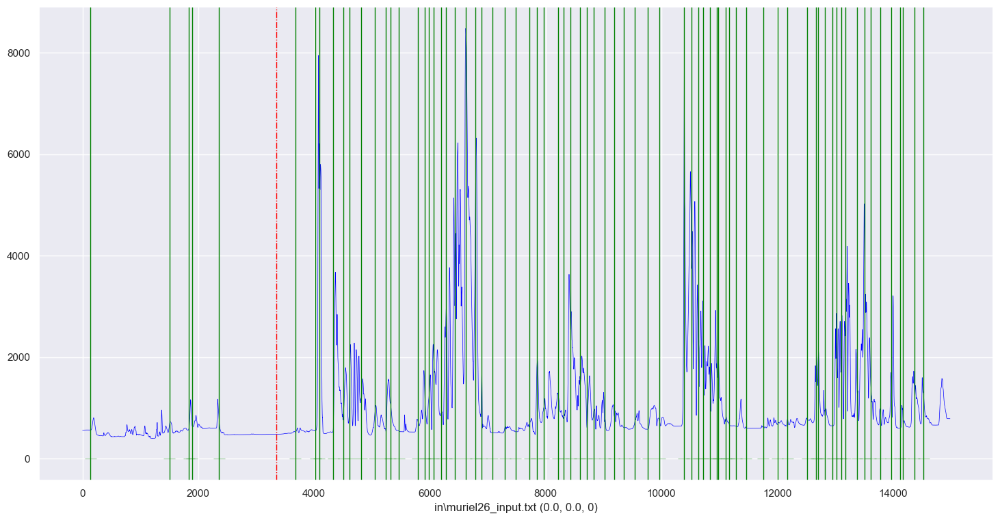

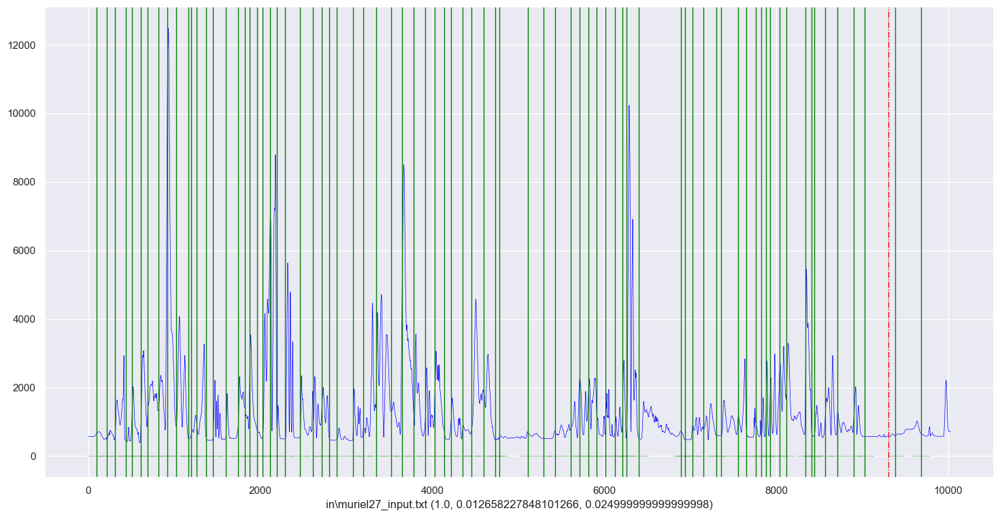

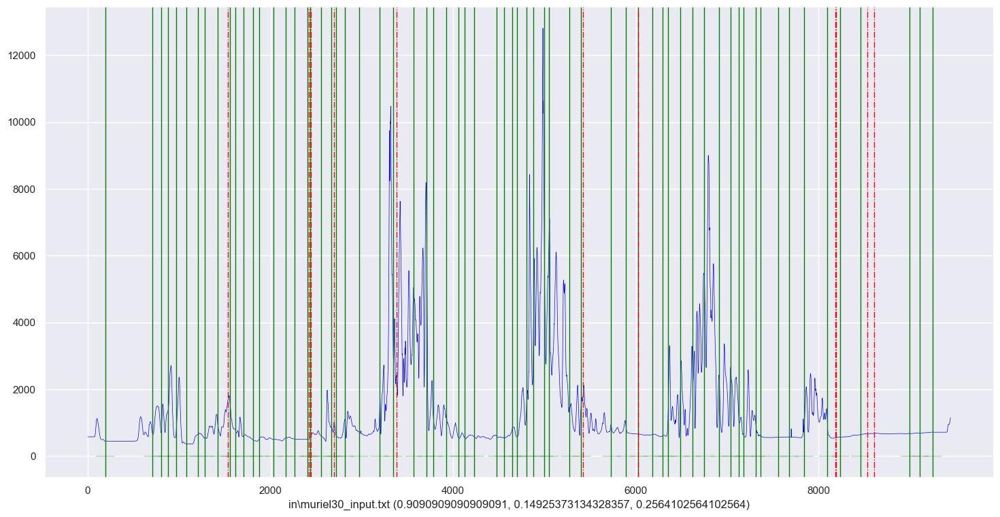

In [14]:
# suss
for i in range(len(timeseries)):
    print(i)
    df=ReadAndPreProcess(timeseries[i])
    gt=LoadingGroundTruth(df,groundtruth[i])
    cp,eachcp,clasp=GetClasp(df,gt,0)
    PlotResult(df,gt,cp, timeseries[i], 100)
    Evaluate("CLASP",groundtruth[i],gt,timeseries[i],cp,df,100,"suss",timeseries[i])

0
f1margin: (0.2857142857142857, 0.125, 0.17391304347826086)
1
f1margin: (0.5, 0.25, 0.3333333333333333)
2
f1margin: (0.23529411764705882, 0.9411764705882353, 0.3764705882352941)
3
f1margin: (1.0, 0.16, 0.2758620689655173)
4
f1margin: (0.75, 0.14285714285714285, 0.24)
5
f1margin: (0.3333333333333333, 0.037037037037037035, 0.06666666666666667)
6
f1margin: (1.0, 0.07692307692307693, 0.14285714285714288)
7


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (1.0, 0.19230769230769232, 0.32258064516129037)
8
f1margin: (1.0, 0.06666666666666667, 0.125)
9
f1margin: (0.0, 0.0, 0)
10
f1margin: (0.3333333333333333, 0.047619047619047616, 0.08333333333333333)
11


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (1.0, 0.23076923076923078, 0.375)
12
f1margin: (0.0, 0.0, 0)
13
f1margin: (1.0, 0.05128205128205128, 0.09756097560975609)
14
f1margin: (0.23076923076923078, 0.17647058823529413, 0.20000000000000004)
15


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (0, 0.0, 0)
16


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (1.0, 0.17647058823529413, 0.3)
17


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (1.0, 0.06976744186046512, 0.13043478260869565)
18
f1margin: (1.0, 0.02857142857142857, 0.05555555555555556)
19
f1margin: (0.75, 0.04, 0.07594936708860758)
20


C:\Users\loluc\AppData\Local\Temp\ipykernel_18008\8351913.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(18,9))


f1margin: (1.0, 0.012658227848101266, 0.024999999999999998)
21
f1margin: (1.0, 0.08955223880597014, 0.1643835616438356)


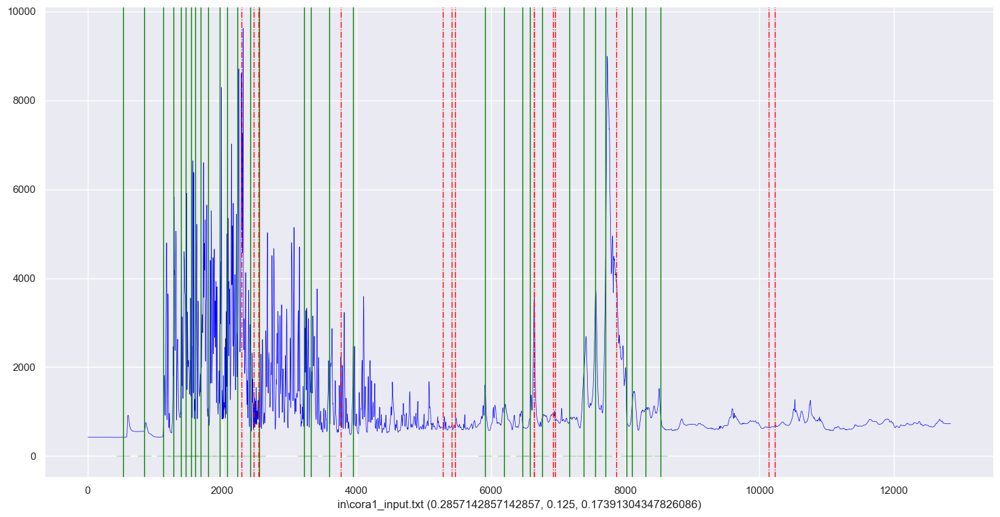

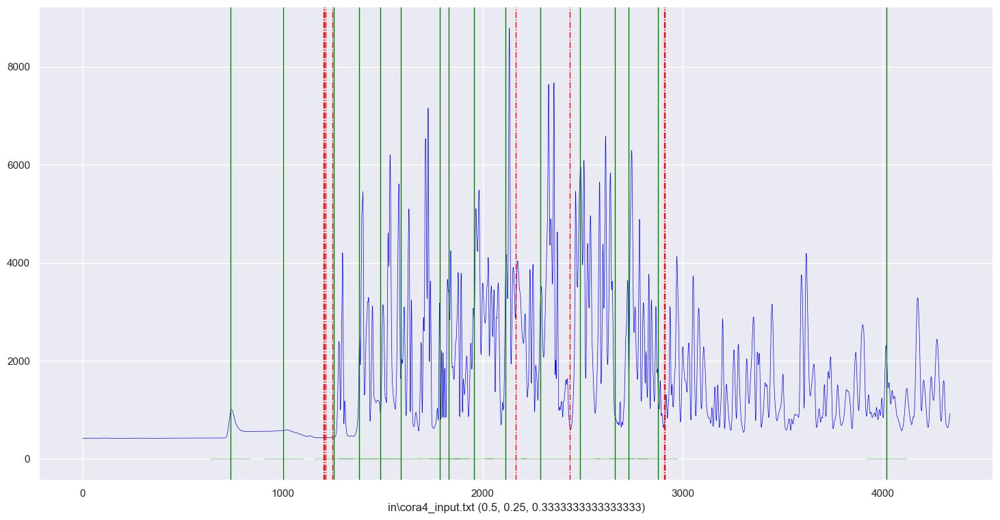

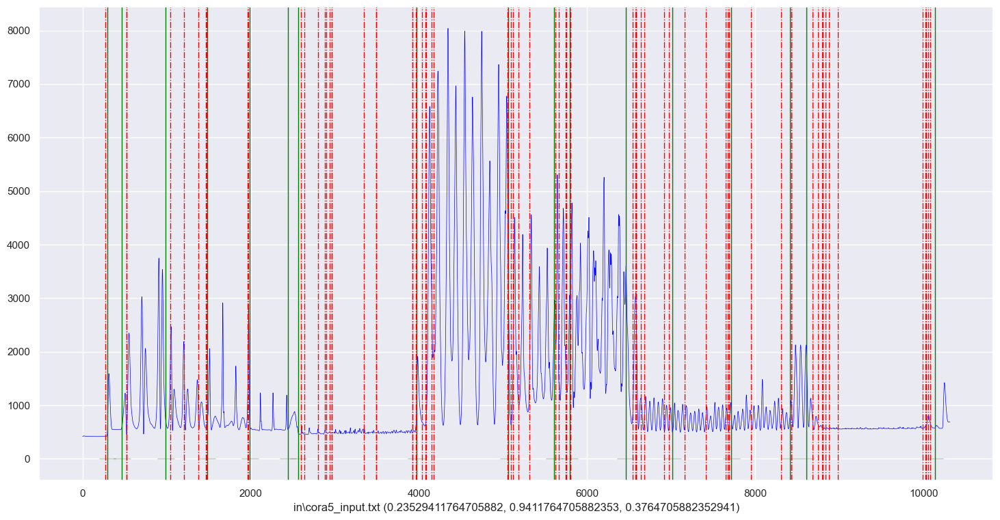

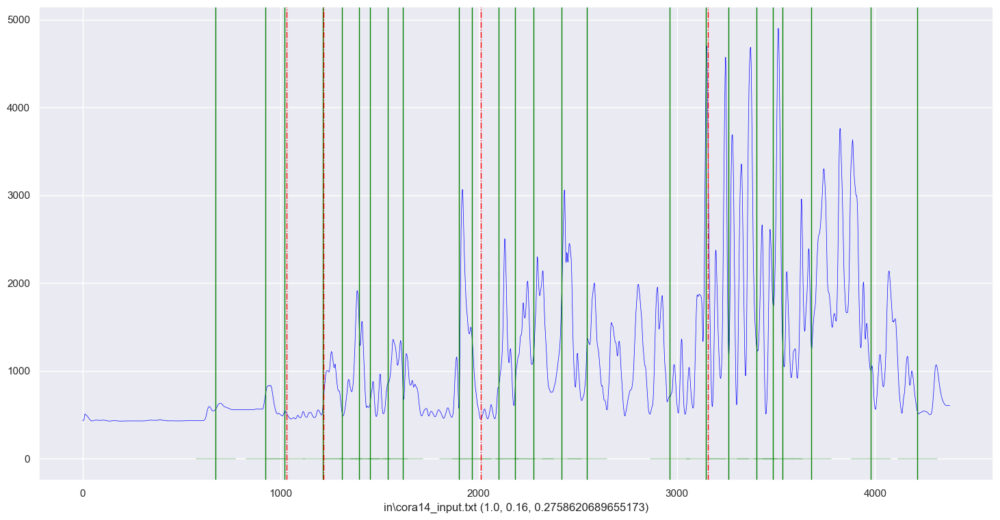

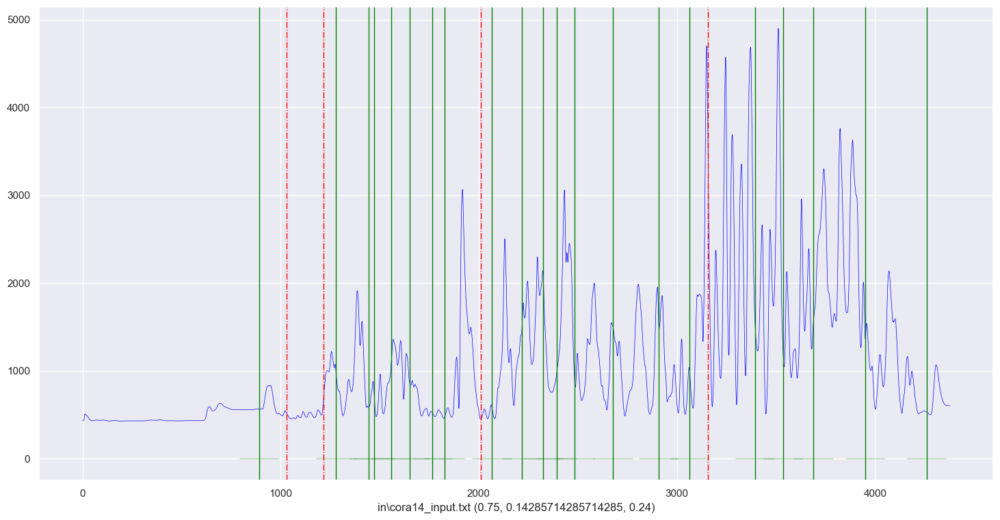

...

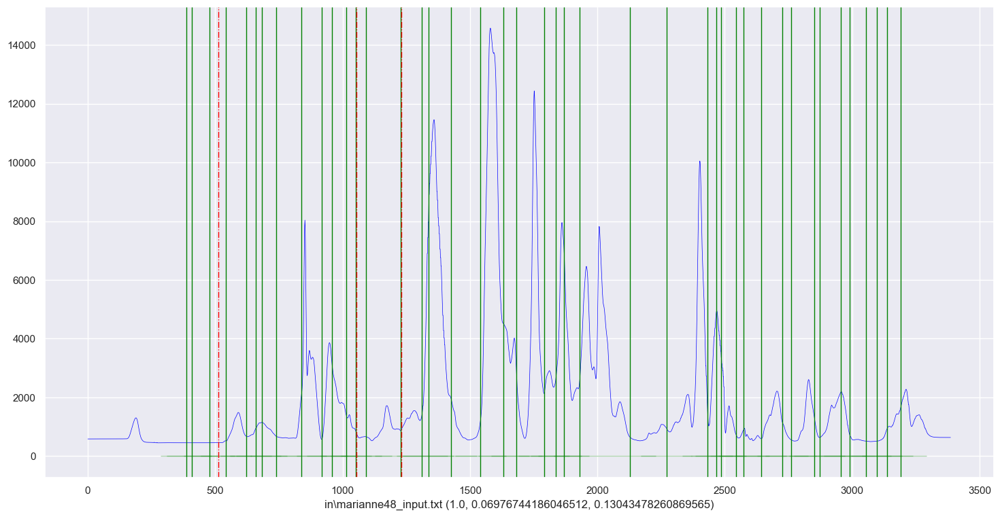

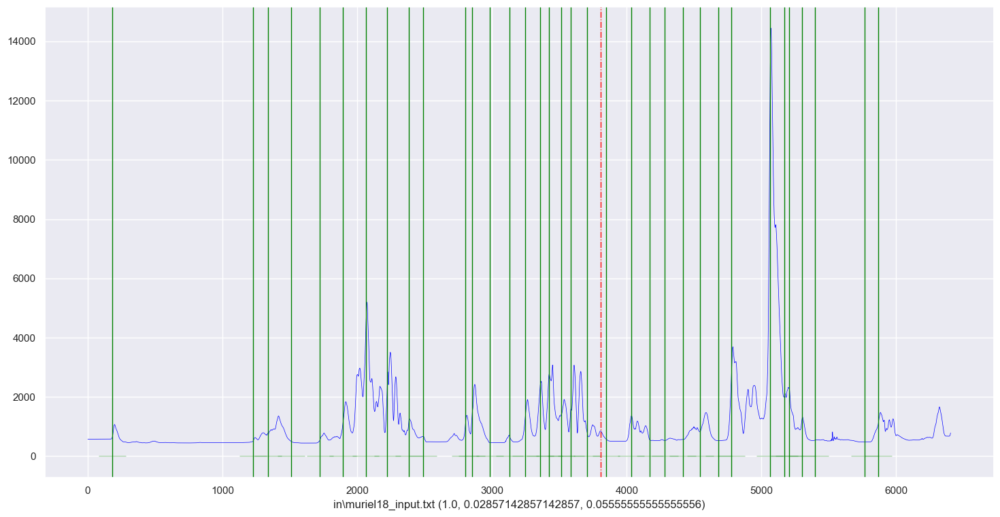

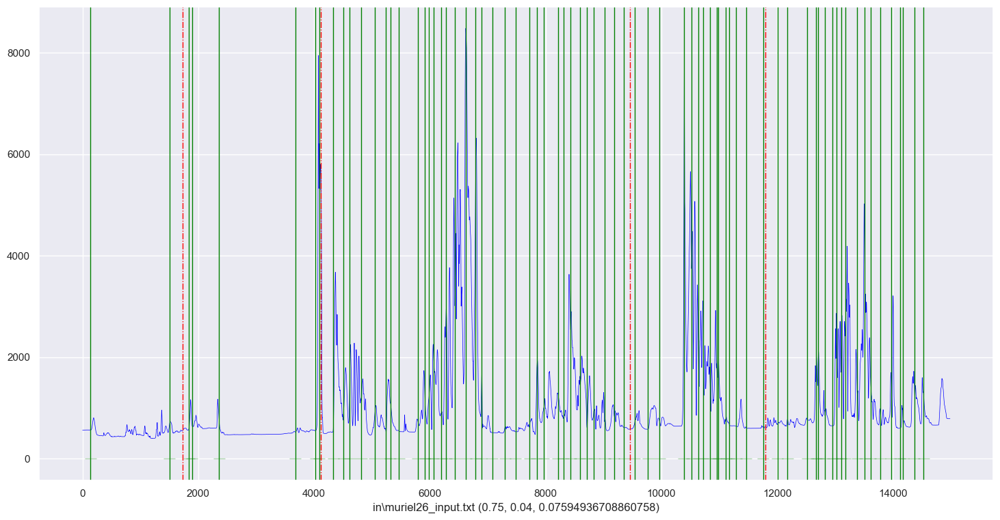

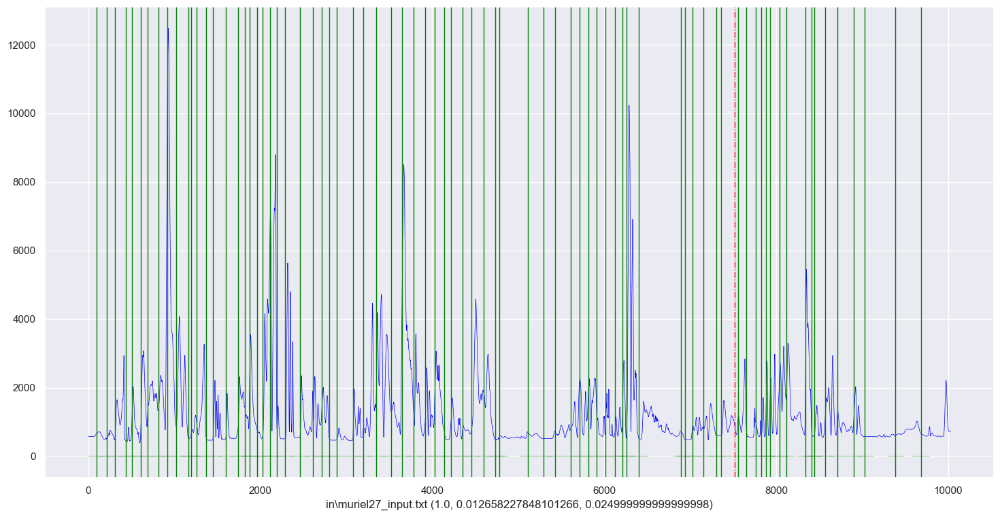

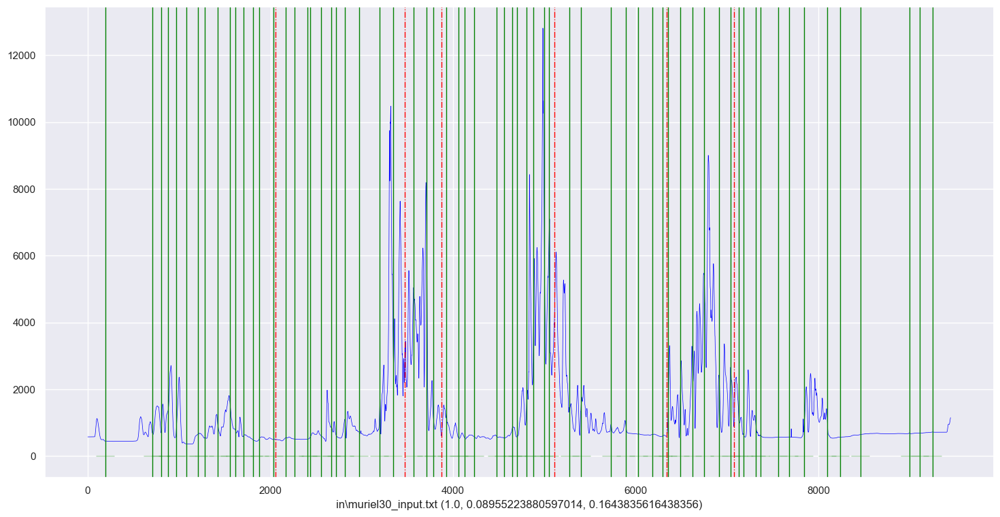

In [15]:
# fft
for i in range(len(timeseries)):
    print(i)
    df=ReadAndPreProcess(timeseries[i])
    gt=LoadingGroundTruth(df,groundtruth[i])
    cp,eachcp,clasp=GetClasp(df,gt,0,window_size="fft")
    PlotResult(df,gt,cp, timeseries[i], 100)
    Evaluate("CLASP",groundtruth[i],gt,timeseries[i],cp,df,100,"fft",timeseries[i])

0
f1margin: (0.2727272727272727, 0.1875, 0.2222222222222222)
1


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (0.625, 0.3125, 0.4166666666666667)
2
f1margin: (0.189873417721519, 0.8823529411764706, 0.3125)
3


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (1.0, 0.16, 0.2758620689655173)
4


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (0.75, 0.14285714285714285, 0.24)
5
f1margin: (0.75, 0.2222222222222222, 0.34285714285714286)
6


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (1.0, 0.038461538461538464, 0.07407407407407407)
7


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (1.0, 0.038461538461538464, 0.07407407407407407)
8
f1margin: (1.0, 0.044444444444444446, 0.0851063829787234)
9
f1margin: (0.5, 0.045454545454545456, 0.08333333333333334)
10
f1margin: (0.3333333333333333, 0.047619047619047616, 0.08333333333333333)
11
f1margin: (1.0, 0.15384615384615385, 0.2666666666666667)
12


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (0.0, 0.0, 0)
13


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\window_size.py:213: UserWarning: Could not find any autocorrelation peaks. Using window_size=10.
  warnings.warn(f"Could not find any autocorrelation peaks. Using window_size={lbound}.")


f1margin: (1.0, 0.05128205128205128, 0.09756097560975609)
14
f1margin: (0.15, 0.17647058823529413, 0.16216216216216214)
15


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (1.0, 0.058823529411764705, 0.1111111111111111)
16


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (1.0, 0.17647058823529413, 0.3)
17


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (1.0, 0.06976744186046512, 0.13043478260869565)
18
f1margin: (1.0, 0.02857142857142857, 0.05555555555555556)
19
f1margin: (0.0, 0.0, 0)
20


C:\Users\loluc\AppData\Local\Temp\ipykernel_18008\8351913.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(18,9))


f1margin: (0, 0.0, 0)
21
f1margin: (0.9166666666666666, 0.16417910447761194, 0.2784810126582279)


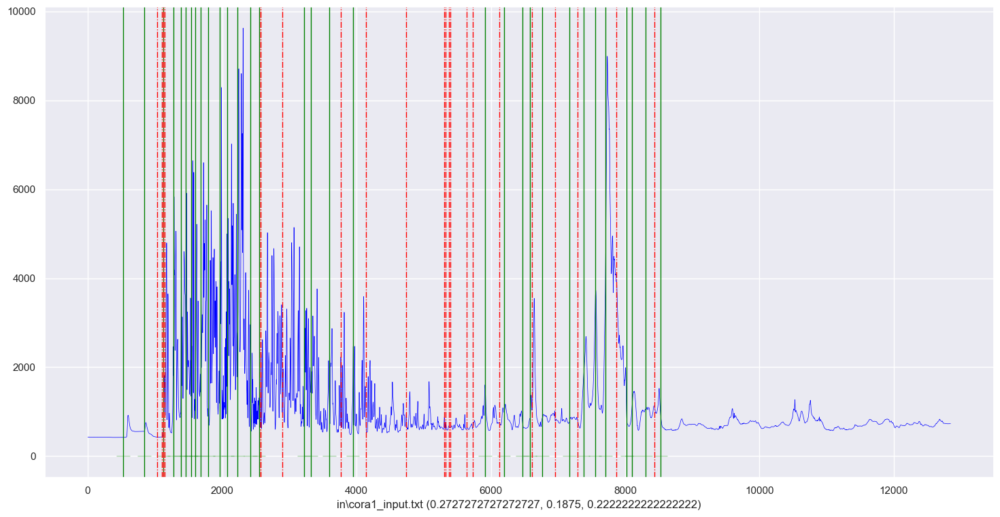

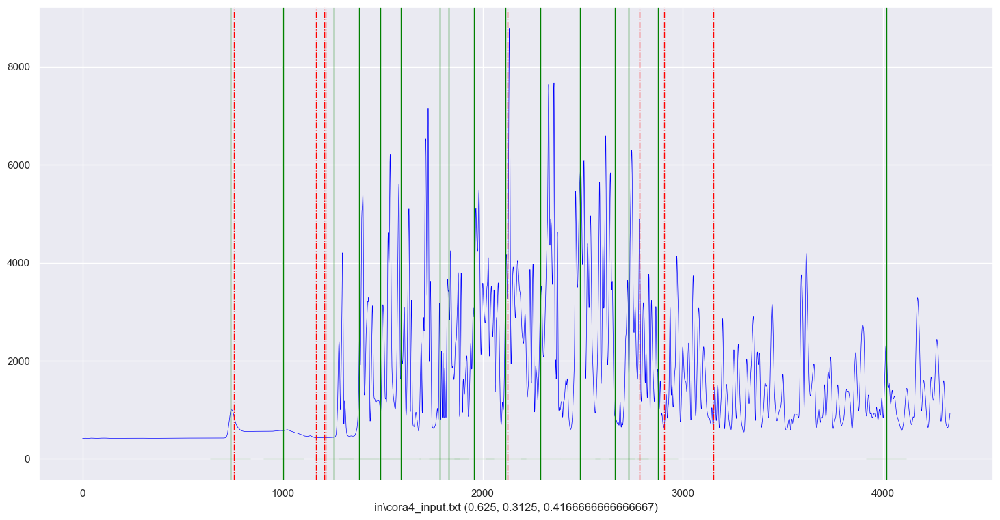

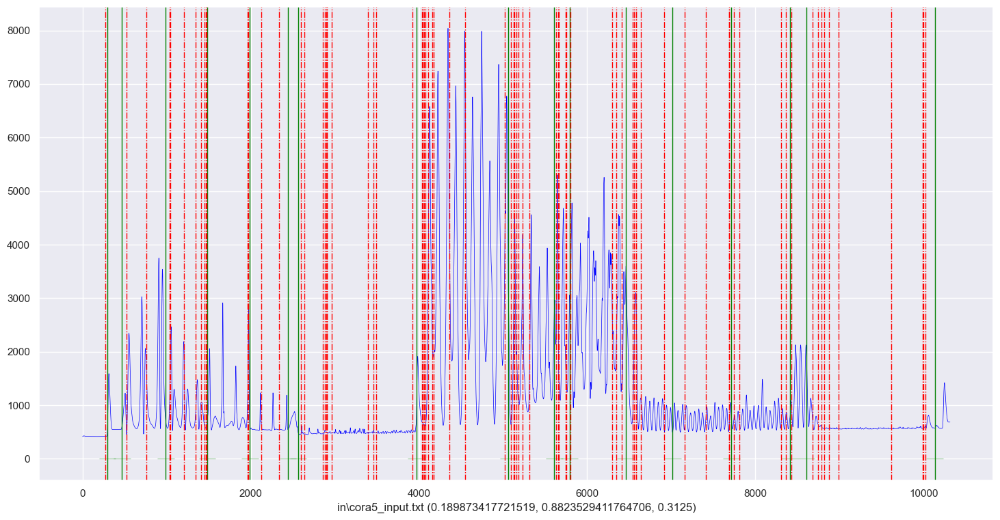

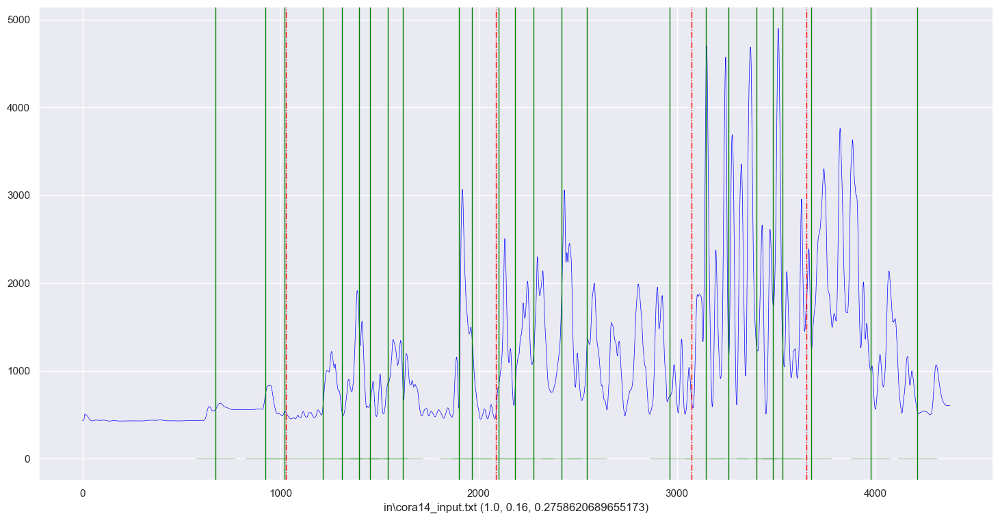

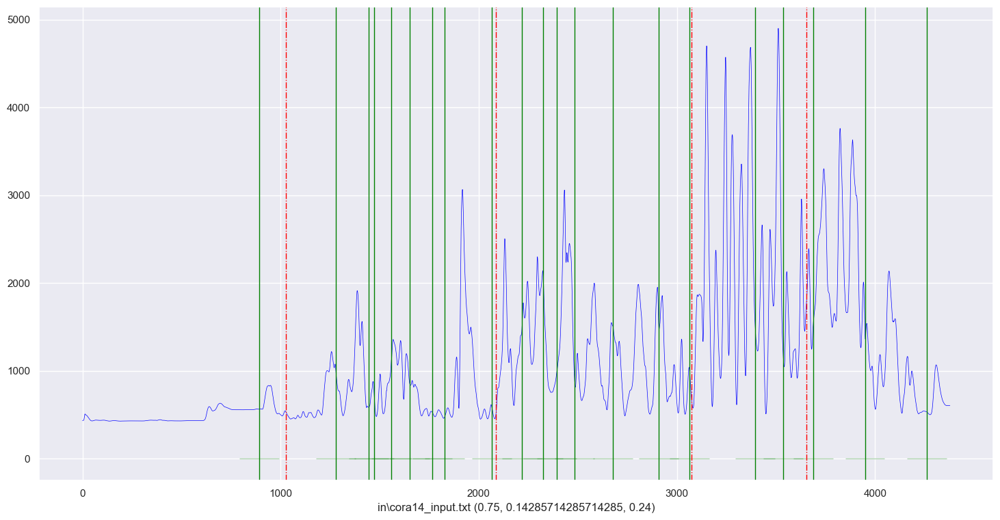

...

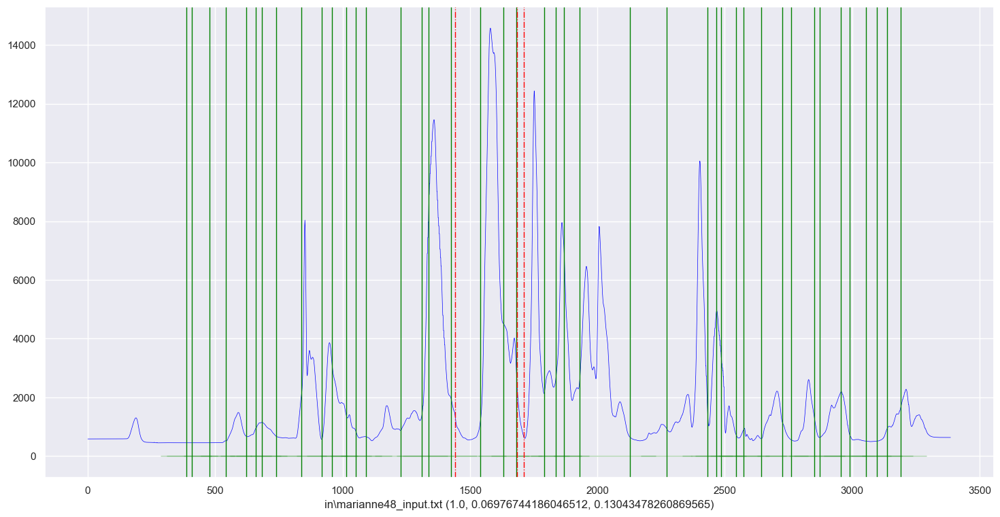

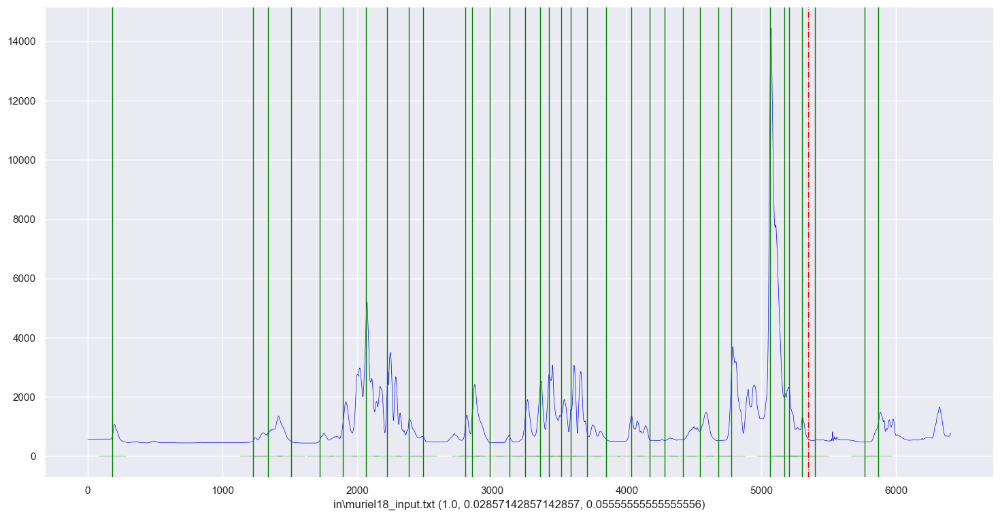

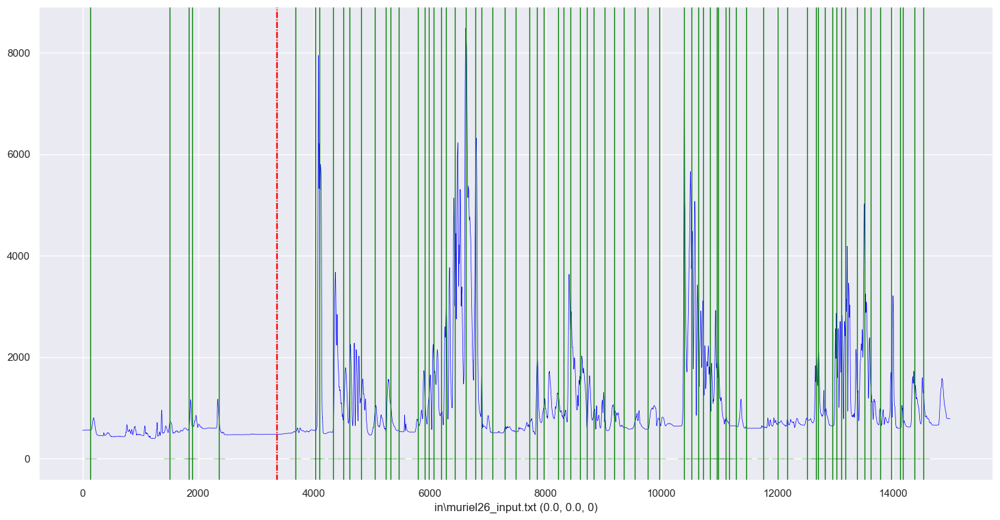

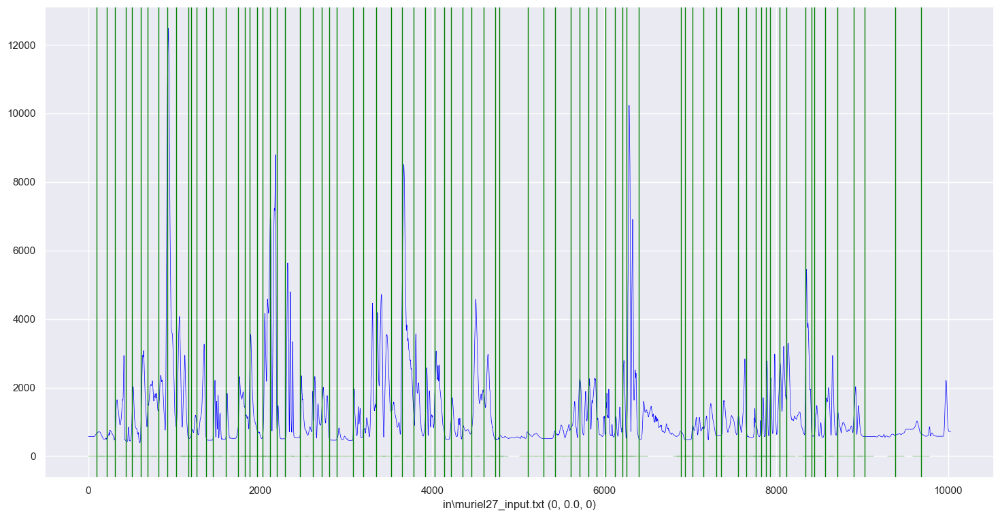

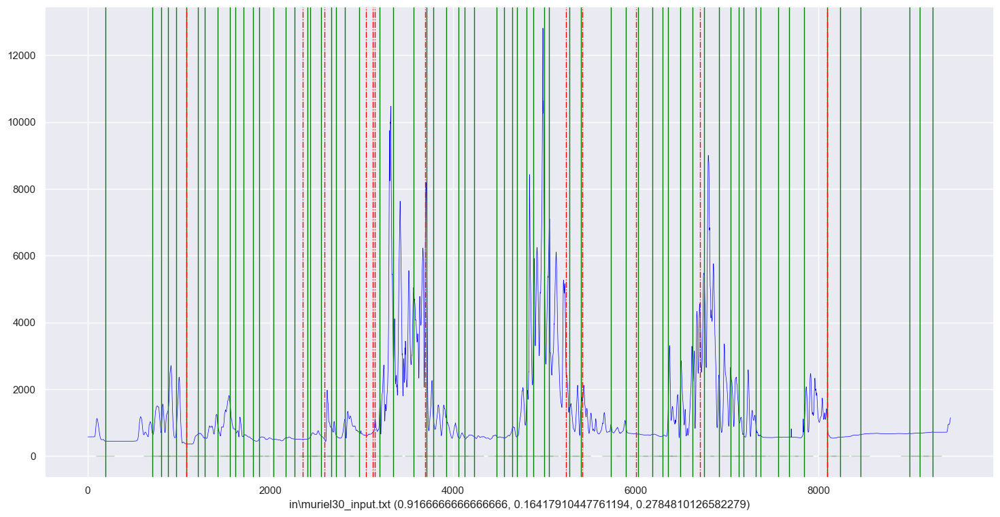

In [16]:
# acf
for i in range(len(timeseries)):
    print(i)
    df=ReadAndPreProcess(timeseries[i])
    gt=LoadingGroundTruth(df,groundtruth[i])
    cp,eachcp,clasp=GetClasp(df,gt,0,window_size="acf")
    PlotResult(df,gt,cp, timeseries[i], 100)
    Evaluate("CLASP",groundtruth[i],gt,timeseries[i],cp,df,100,"acf",timeseries[i])

0
f1margin: (0.24691358024691357, 0.625, 0.35398230088495575)
1
f1margin: (0.2571428571428571, 0.5625, 0.3529411764705882)
2
f1margin: (0.13675213675213677, 0.9411764705882353, 0.23880597014925378)
3
f1margin: (0.4642857142857143, 0.52, 0.49056603773584906)
4
f1margin: (0.32142857142857145, 0.42857142857142855, 0.3673469387755102)
5
f1margin: (0.35714285714285715, 0.7407407407407407, 0.48192771084337344)
6
f1margin: (0.36363636363636365, 0.3076923076923077, 0.33333333333333337)
7
f1margin: (0.43478260869565216, 0.38461538461538464, 0.40816326530612246)
8
f1margin: (0.43478260869565216, 0.2222222222222222, 0.29411764705882354)
9
f1margin: (0.28, 0.3181818181818182, 0.29787234042553196)
10
f1margin: (0.2653061224489796, 0.6190476190476191, 0.37142857142857144)
11
f1margin: (0.23076923076923078, 0.23076923076923078, 0.23076923076923078)
12
f1margin: (0.12, 0.3333333333333333, 0.1764705882352941)
13
f1margin: (0.48148148148148145, 0.6666666666666666, 0.5591397849462365)
14
f1margin: (0.114

C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\scipy\stats\_stats_py.py:9205: RuntimeWarning: invalid value encountered in scalar divide
  z = (s - expected) / np.sqrt(n1*n2*(n1+n2+1)/12.0)


f1margin: (0.4626865671641791, 0.41333333333333333, 0.43661971830985913)
20


C:\Users\loluc\AppData\Local\Temp\ipykernel_18008\8351913.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(18,9))


f1margin: (0.8709677419354839, 0.34177215189873417, 0.4909090909090909)
21
f1margin: (0.6022727272727273, 0.7910447761194029, 0.6838709677419355)


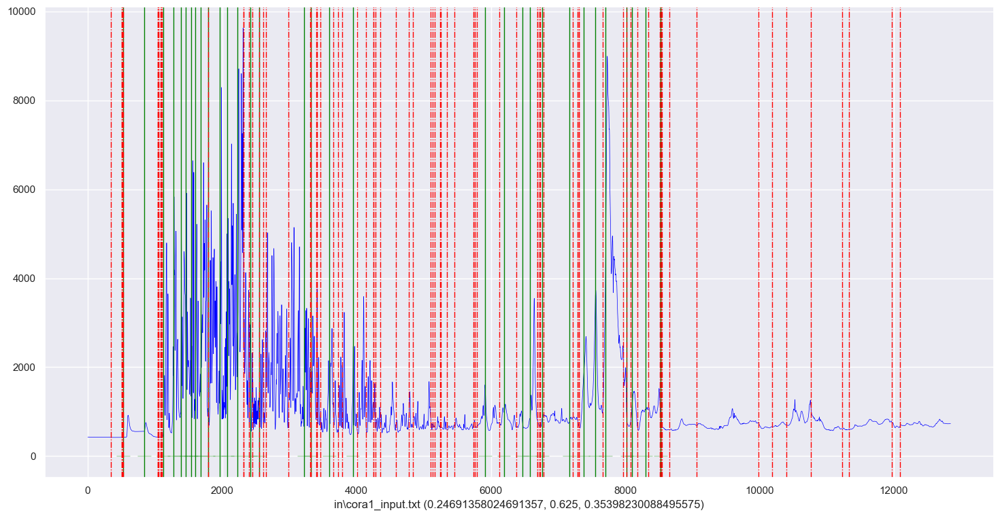

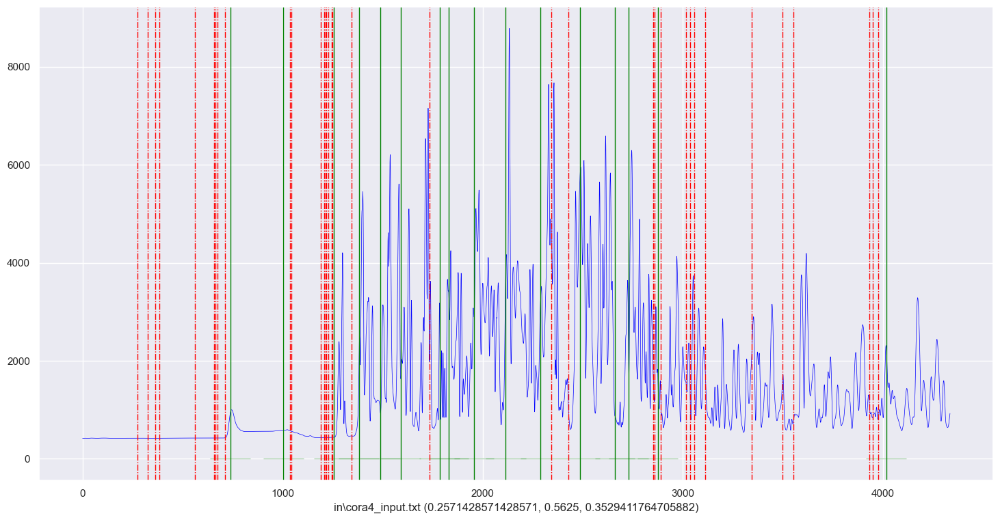

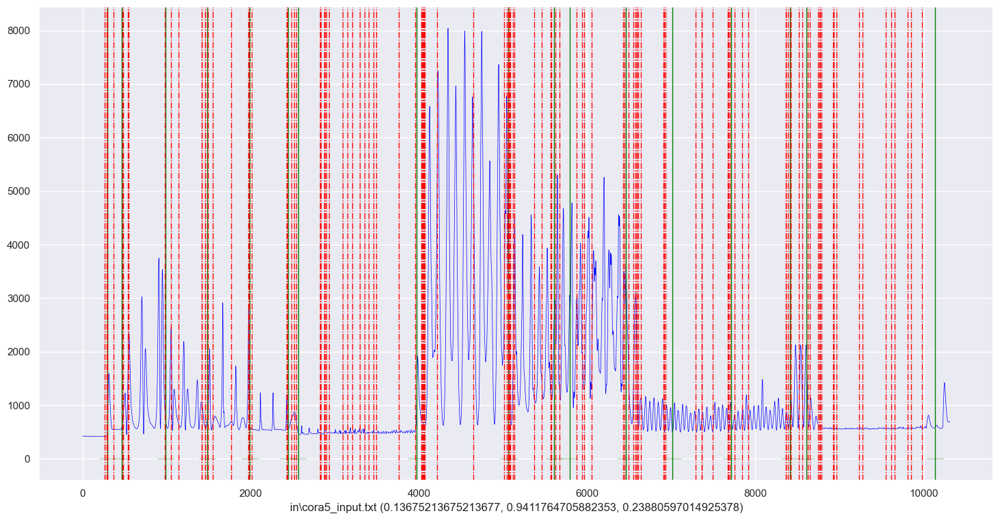

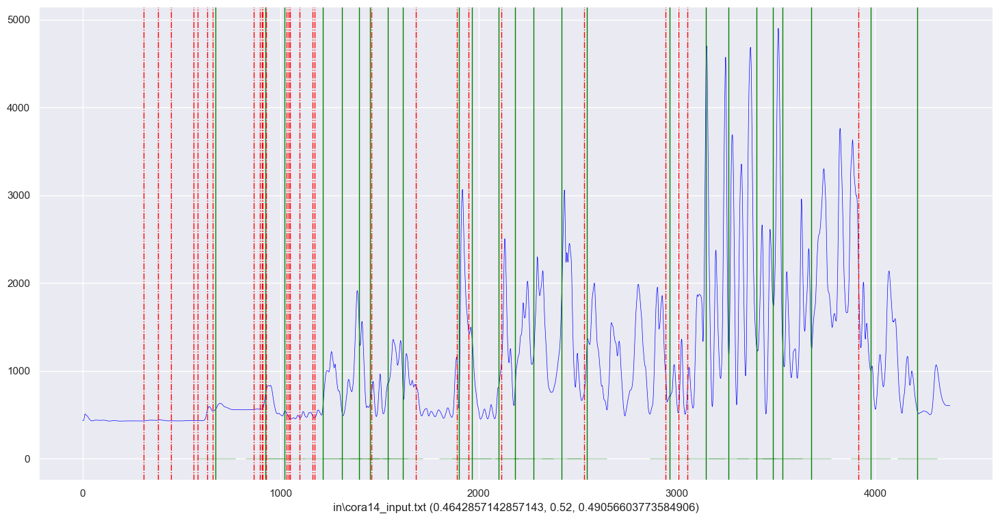

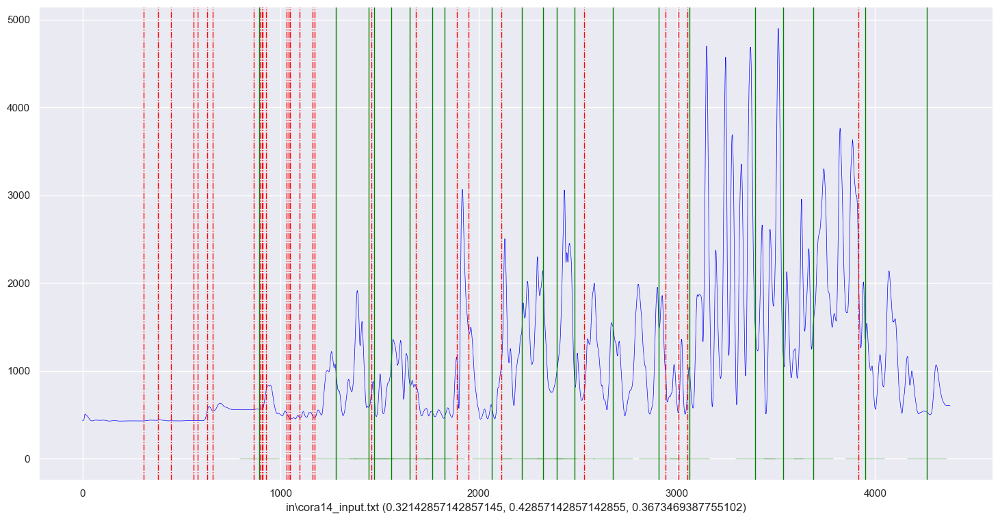

...

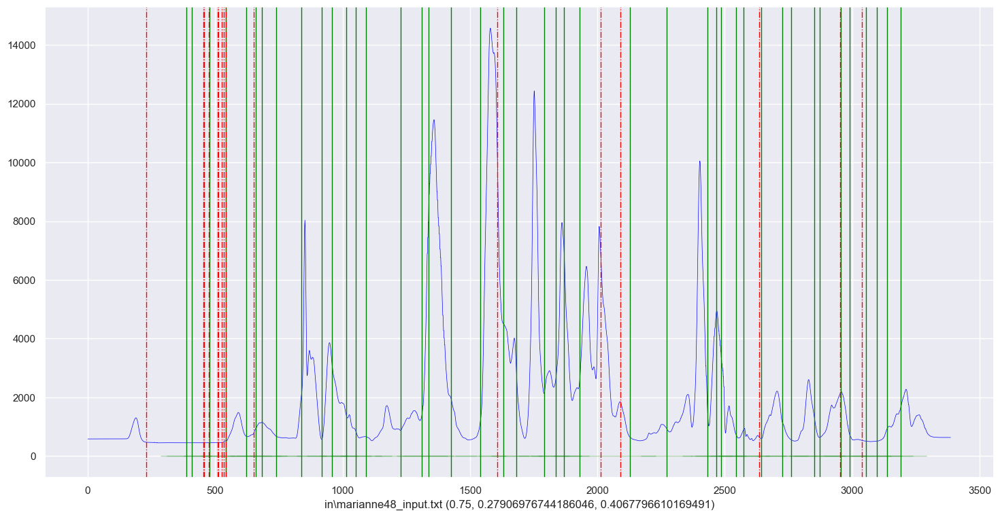

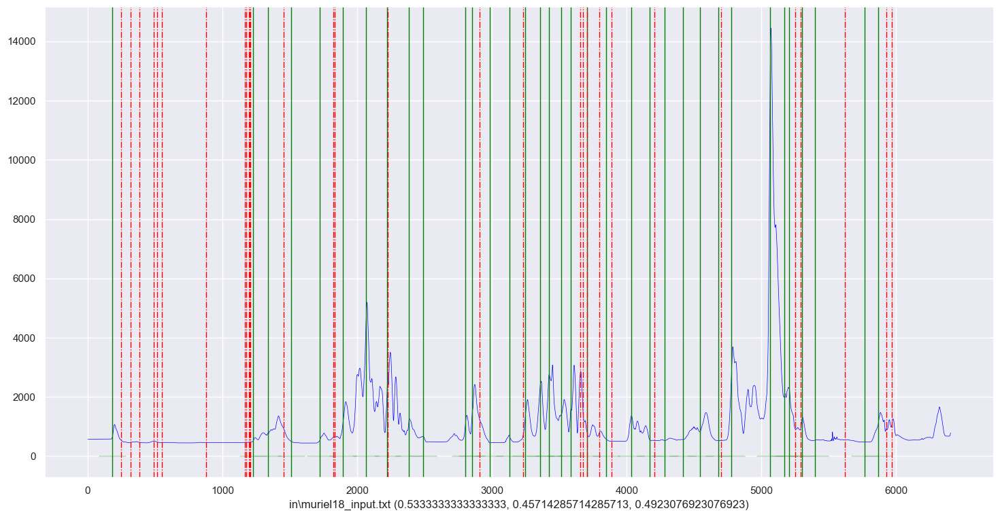

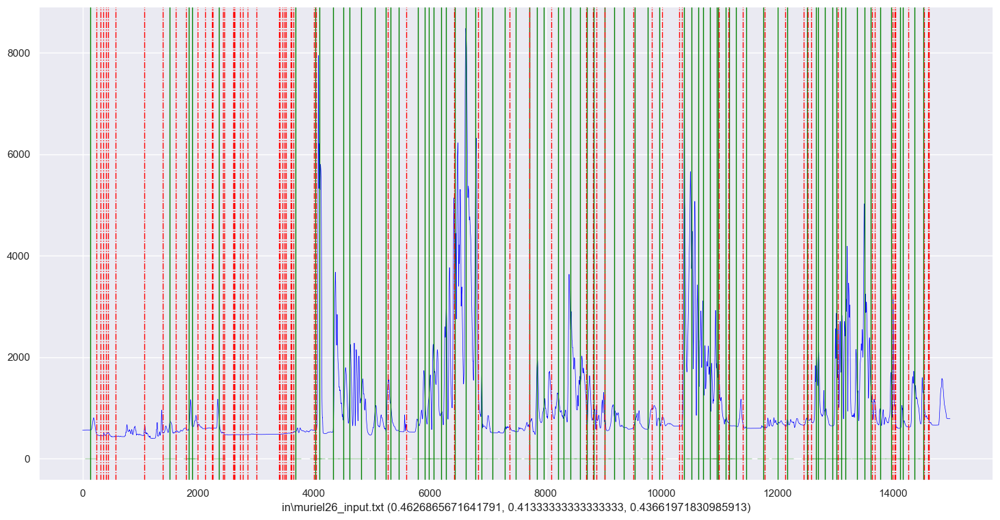

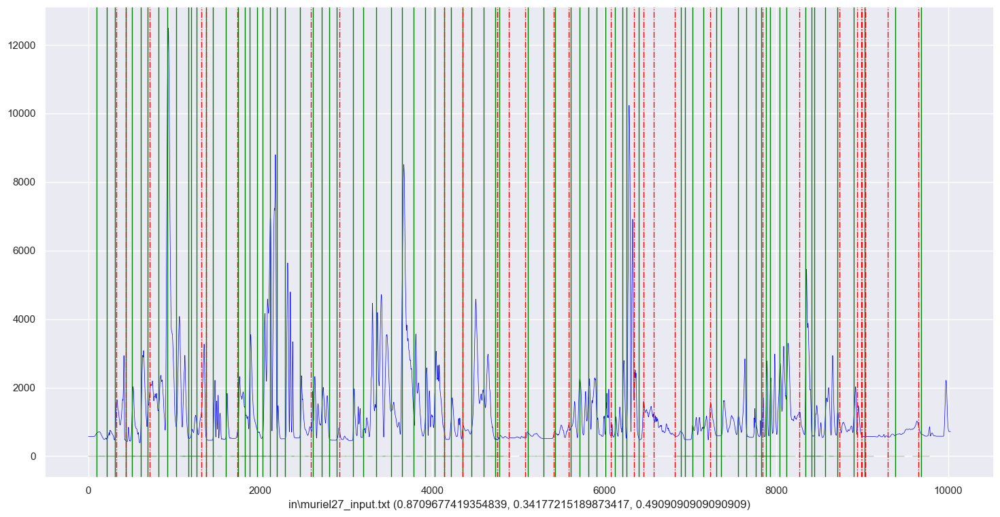

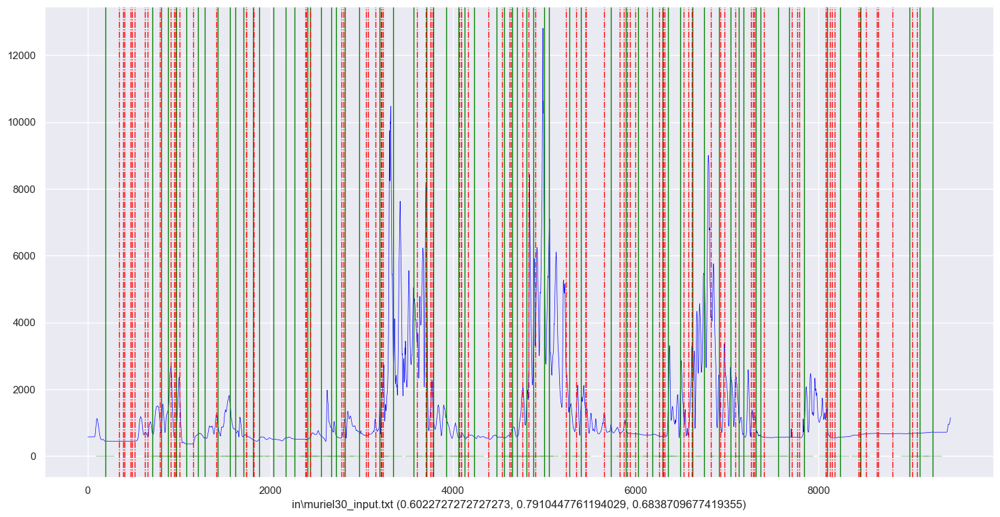

In [17]:
# suss, euclidean
for i in range(len(timeseries)):
    print(i)
    df=ReadAndPreProcess(timeseries[i])
    gt=LoadingGroundTruth(df,groundtruth[i])
    cp,eachcp,clasp=GetClasp(df,gt,0,window_size="suss", distance="euclidean_distance")
    PlotResult(df,gt,cp, timeseries[i], 100)
    Evaluate("CLASP",groundtruth[i],gt,timeseries[i],cp,df,100,"suss euclidean",timeseries[i])

0
f1margin: (0.35294117647058826, 0.375, 0.3636363636363636)
1
f1margin: (0.2777777777777778, 0.3125, 0.29411764705882354)
2
f1margin: (0.16666666666666666, 1.0, 0.2857142857142857)
3
f1margin: (0.7777777777777778, 0.56, 0.6511627906976745)
4
f1margin: (0.5, 0.42857142857142855, 0.4615384615384615)
5
f1margin: (0.5454545454545454, 0.4444444444444444, 0.4897959183673469)
6
f1margin: (0.6875, 0.4230769230769231, 0.5238095238095238)
7


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (1.0, 0.23076923076923078, 0.375)
8
f1margin: (1.0, 0.26666666666666666, 0.4210526315789474)
9
f1margin: (0.5625, 0.4090909090909091, 0.47368421052631576)
10
f1margin: (0.4666666666666667, 0.3333333333333333, 0.3888888888888889)
11


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (0.42857142857142855, 0.23076923076923078, 0.3)
12
f1margin: (0.0, 0.0, 0)
13
f1margin: (0.5, 0.20512820512820512, 0.29090909090909095)
14
f1margin: (0.22857142857142856, 0.47058823529411764, 0.3076923076923077)
15


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (0.7142857142857143, 0.29411764705882354, 0.4166666666666667)
16


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (0.5454545454545454, 0.35294117647058826, 0.42857142857142855)
17


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (1.0, 0.2558139534883721, 0.40740740740740744)
18
f1margin: (0.8333333333333334, 0.14285714285714285, 0.2439024390243902)
19
f1margin: (0.5, 0.13333333333333333, 0.2105263157894737)
20


C:\Users\loluc\AppData\Local\Temp\ipykernel_18008\8351913.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(18,9))


f1margin: (1.0, 0.20253164556962025, 0.3368421052631579)
21
f1margin: (0.9285714285714286, 0.19402985074626866, 0.32098765432098764)


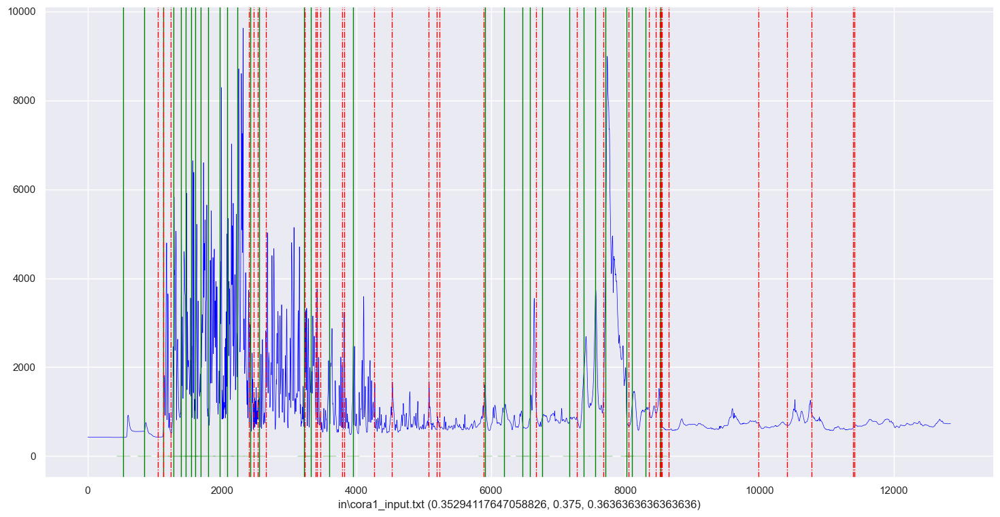

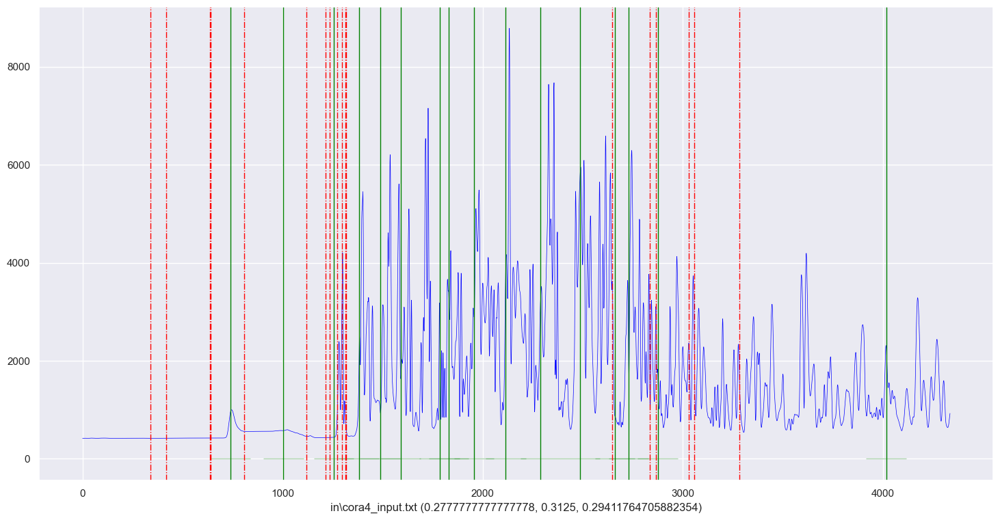

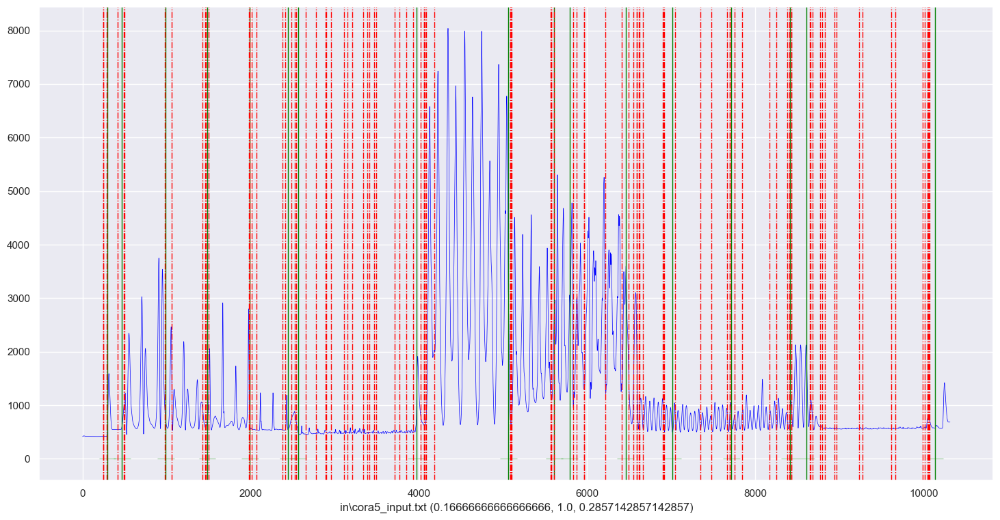

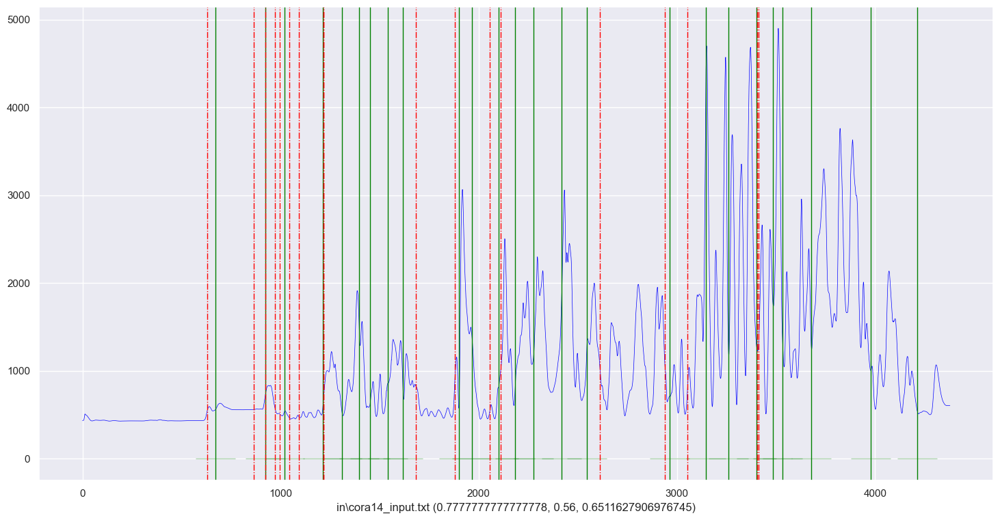

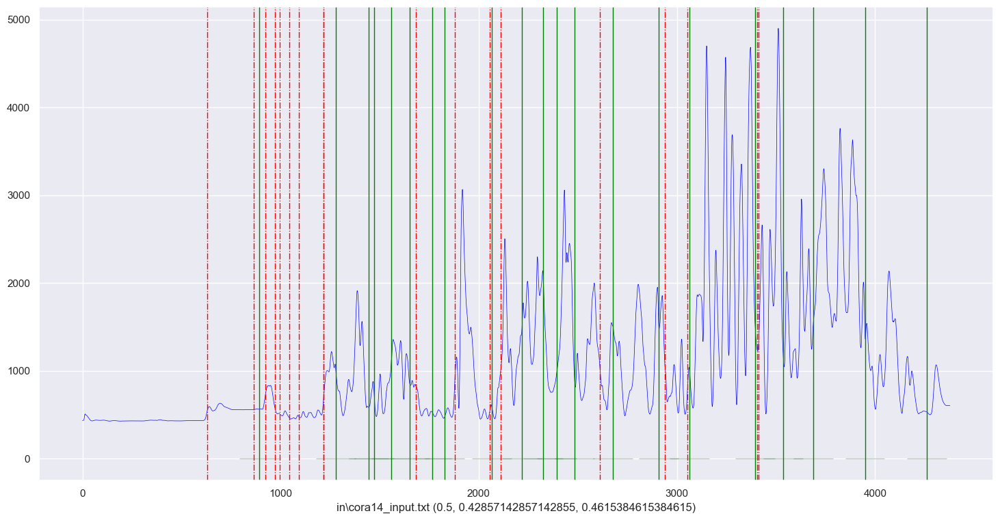

...

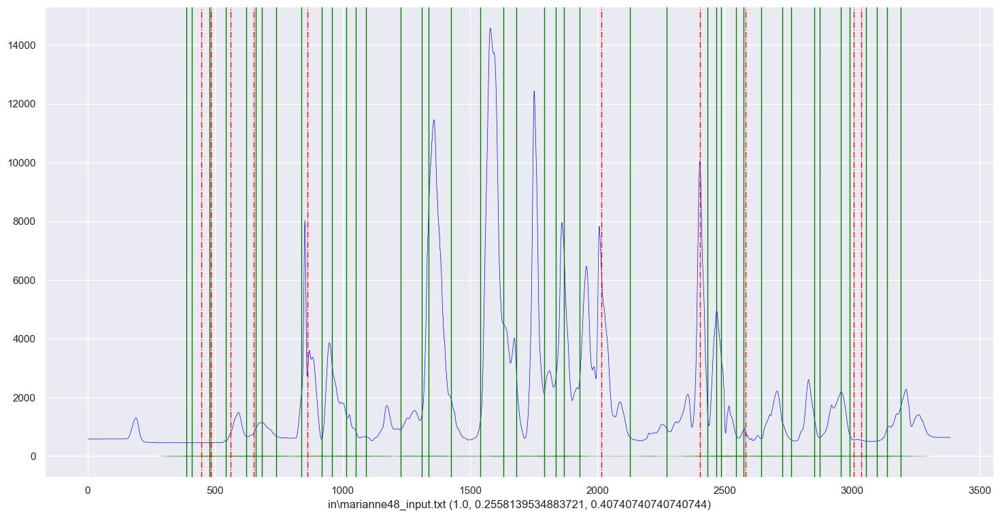

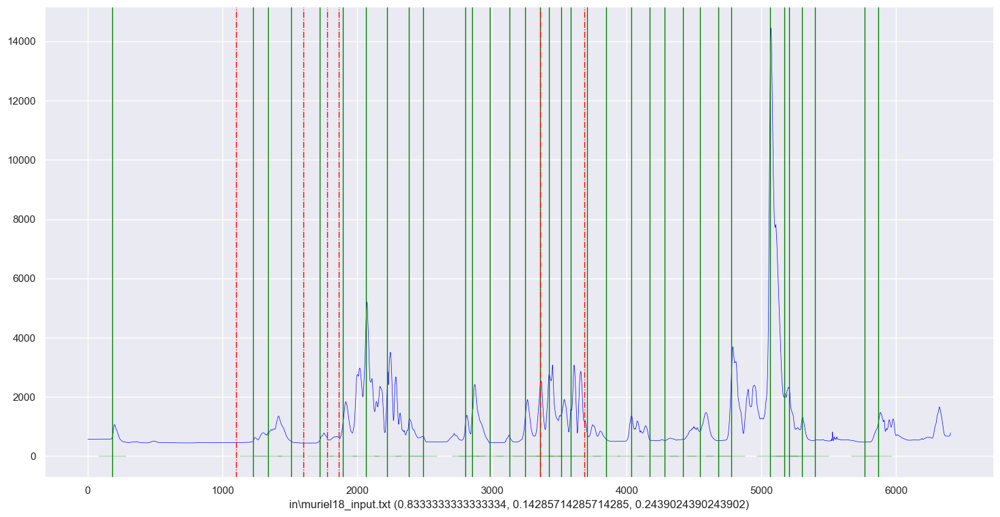

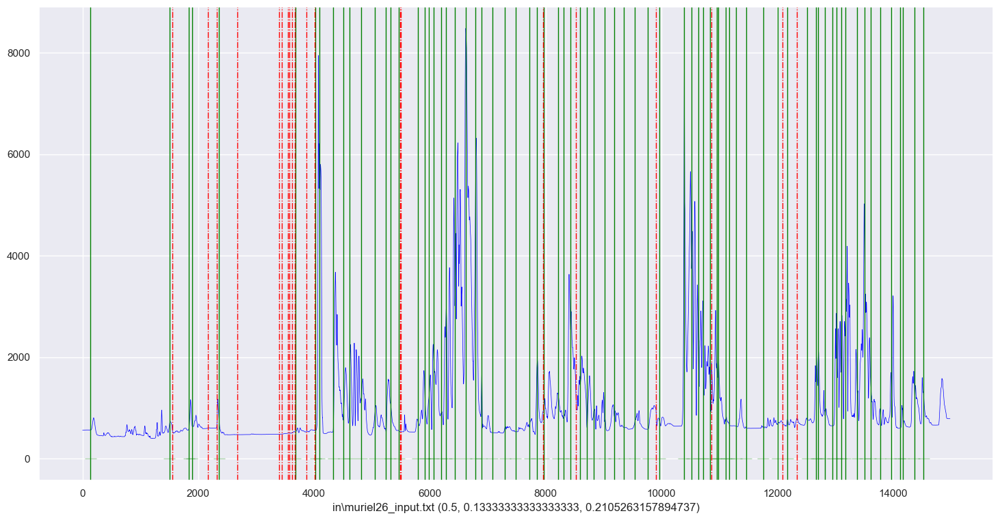

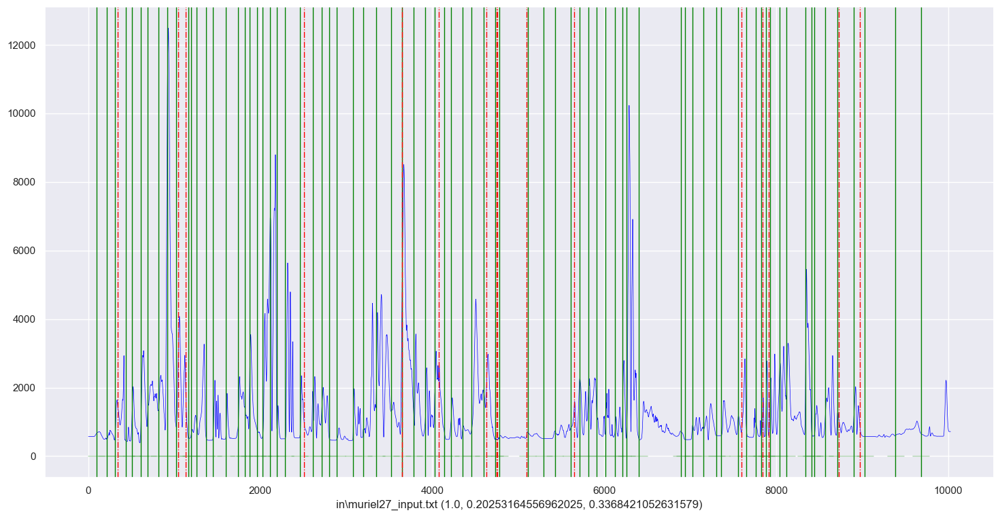

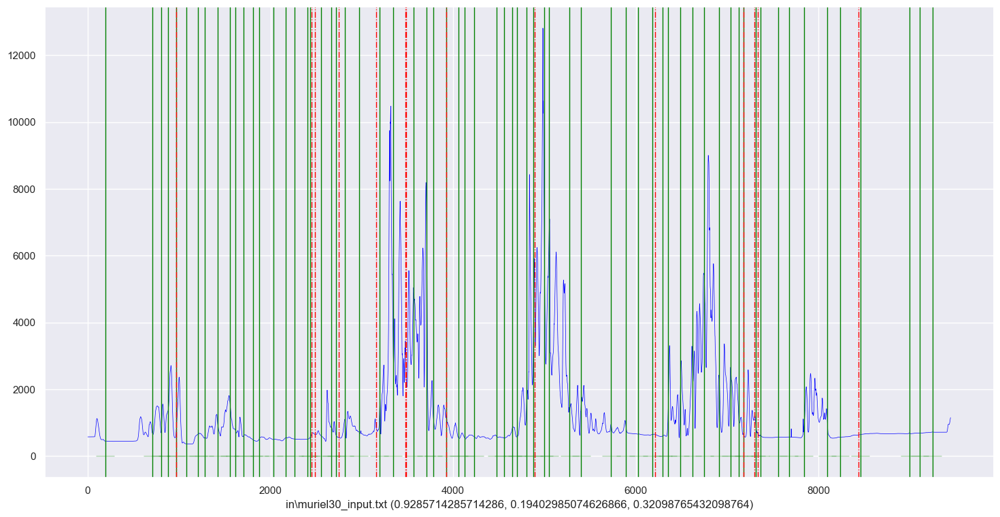

In [18]:
# fft, euclidean
for i in range(len(timeseries)):
    print(i)
    df=ReadAndPreProcess(timeseries[i])
    gt=LoadingGroundTruth(df,groundtruth[i])
    cp,eachcp,clasp=GetClasp(df,gt,0,window_size="fft", distance="euclidean_distance")
    PlotResult(df,gt,cp, timeseries[i], 100)
    Evaluate("CLASP",groundtruth[i],gt,timeseries[i],cp,df,100,"fft euclidean",timeseries[i])

0
f1margin: (0.2537313432835821, 0.53125, 0.3434343434343434)
1


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (0.34615384615384615, 0.5625, 0.4285714285714286)
2
f1margin: (0.13934426229508196, 1.0, 0.24460431654676257)
3


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (0.6363636363636364, 0.56, 0.5957446808510639)
4


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (0.45454545454545453, 0.47619047619047616, 0.46511627906976744)
5
f1margin: (0.5416666666666666, 0.48148148148148145, 0.5098039215686274)
6


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (0.6842105263157895, 0.5, 0.5777777777777778)
7


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (0.7857142857142857, 0.4230769230769231, 0.55)
8
f1margin: (0.8888888888888888, 0.17777777777777778, 0.2962962962962963)
9
f1margin: (0.3225806451612903, 0.45454545454545453, 0.3773584905660377)
10
f1margin: (0.37777777777777777, 0.8095238095238095, 0.5151515151515151)
11
f1margin: (0.42857142857142855, 0.23076923076923078, 0.3)
12


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (0.2857142857142857, 0.4444444444444444, 0.34782608695652173)
13


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\window_size.py:213: UserWarning: Could not find any autocorrelation peaks. Using window_size=10.
  warnings.warn(f"Could not find any autocorrelation peaks. Using window_size={lbound}.")
C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\scipy\stats\_stats_py.py:9205: RuntimeWarning: invalid value encountered in scalar divide
  z = (s - expected) / np.sqrt(n1*n2*(n1+n2+1)/12.0)


f1margin: (0.312, 1.0, 0.47560975609756095)
14
f1margin: (0.09433962264150944, 0.8823529411764706, 0.17045454545454547)
15


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (1.0, 0.29411764705882354, 0.45454545454545453)
16


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (0.5384615384615384, 0.4117647058823529, 0.4666666666666667)
17


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (1.0, 0.3023255813953488, 0.46428571428571425)
18
f1margin: (0.5925925925925926, 0.45714285714285713, 0.5161290322580645)
19
f1margin: (0.4772727272727273, 0.28, 0.3529411764705883)
20


C:\Users\loluc\AppData\Local\Temp\ipykernel_18008\8351913.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(18,9))


f1margin: (0.7727272727272727, 0.21518987341772153, 0.3366336633663366)
21
f1margin: (0.5897435897435898, 0.6865671641791045, 0.6344827586206897)


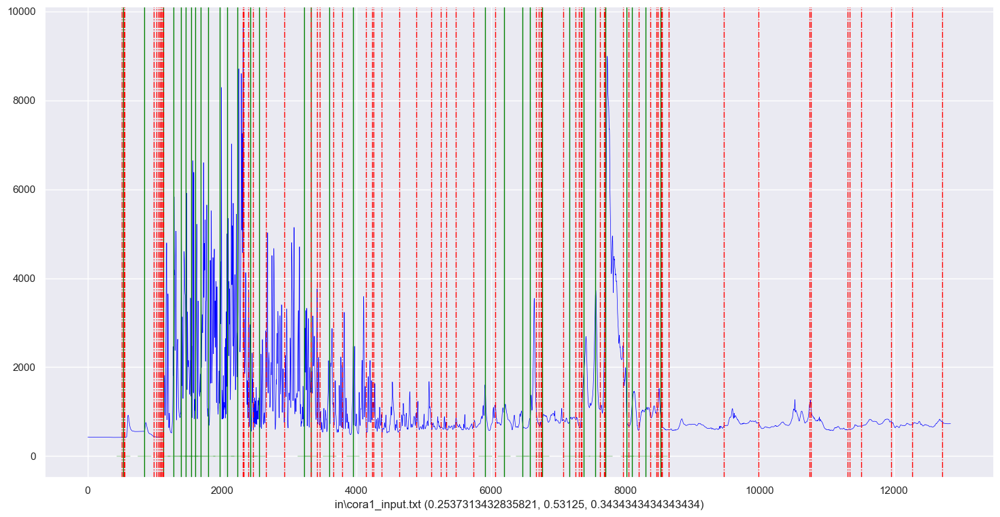

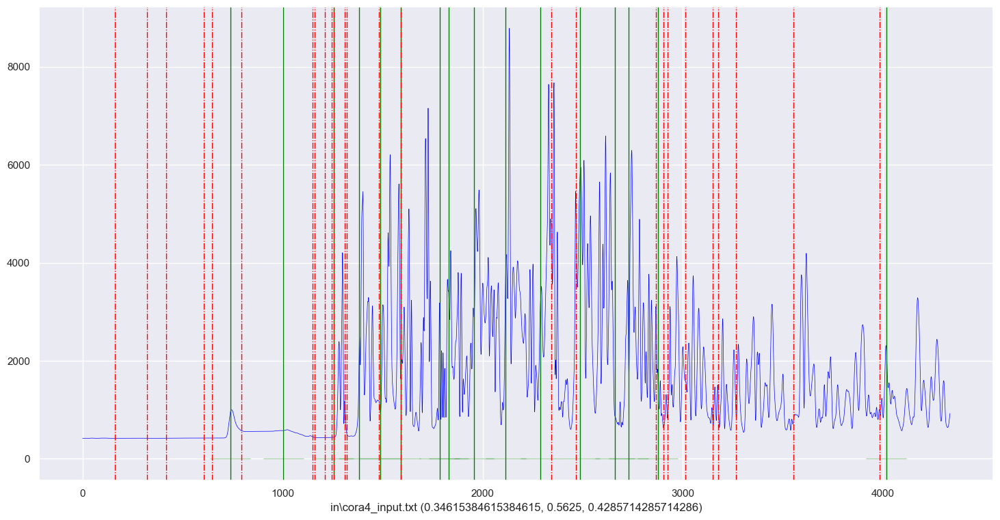

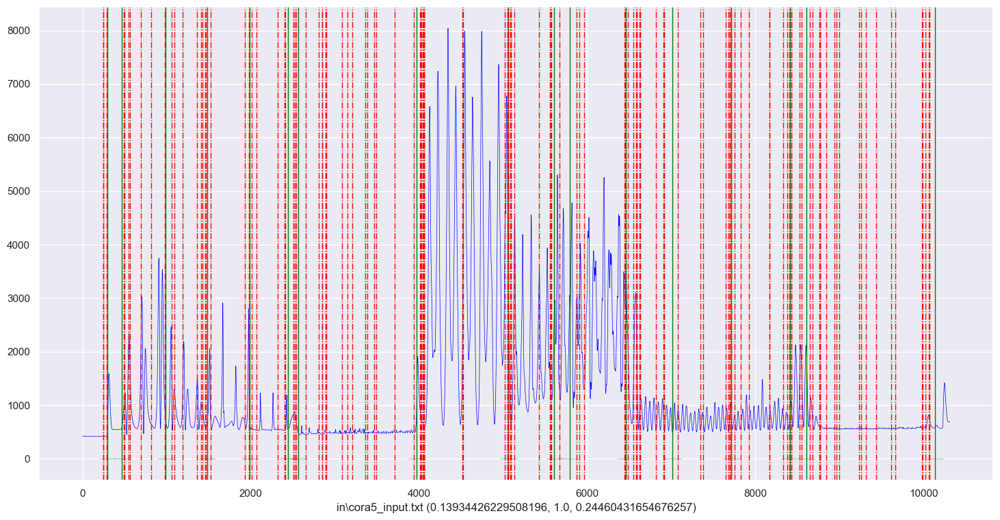

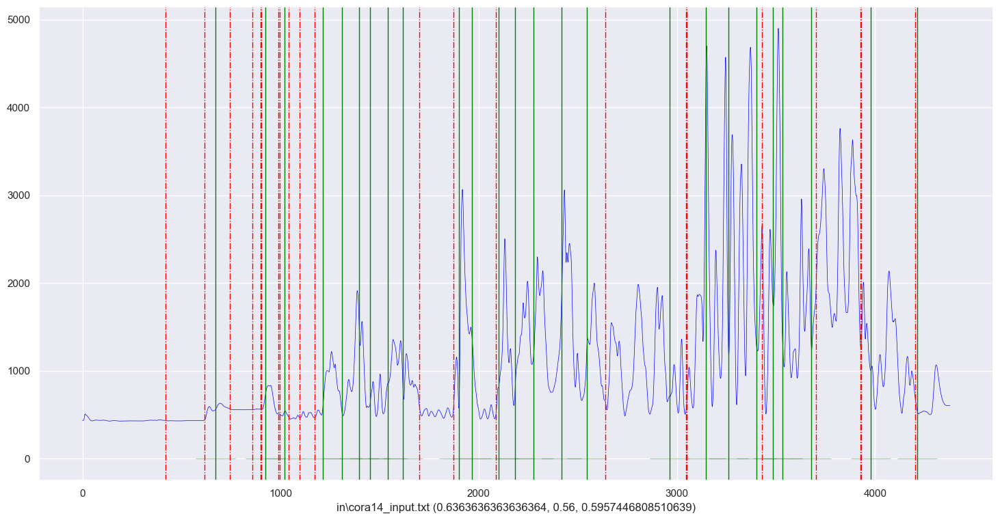

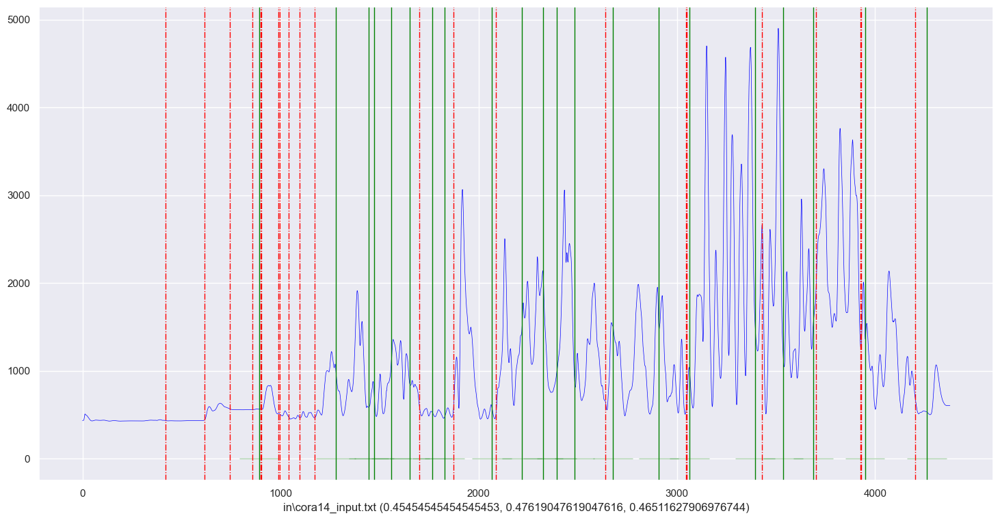

...

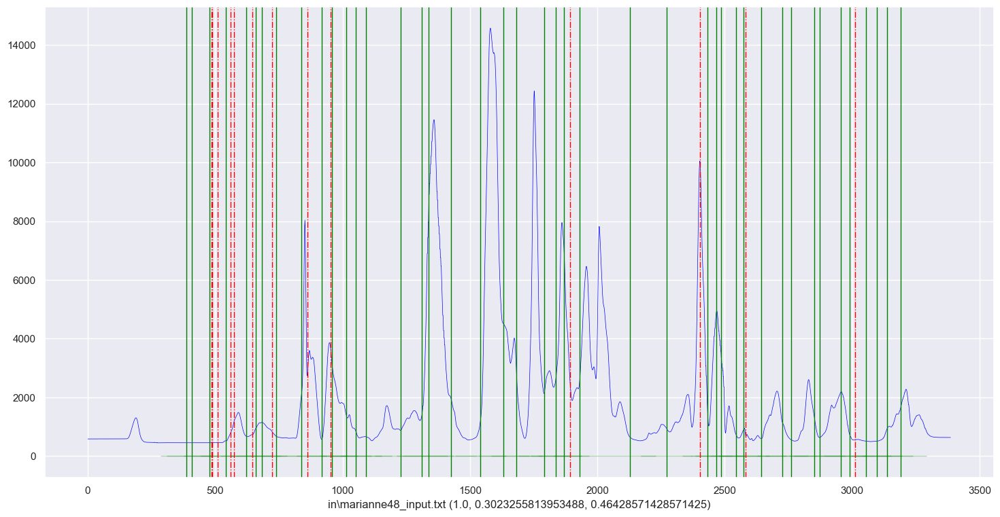

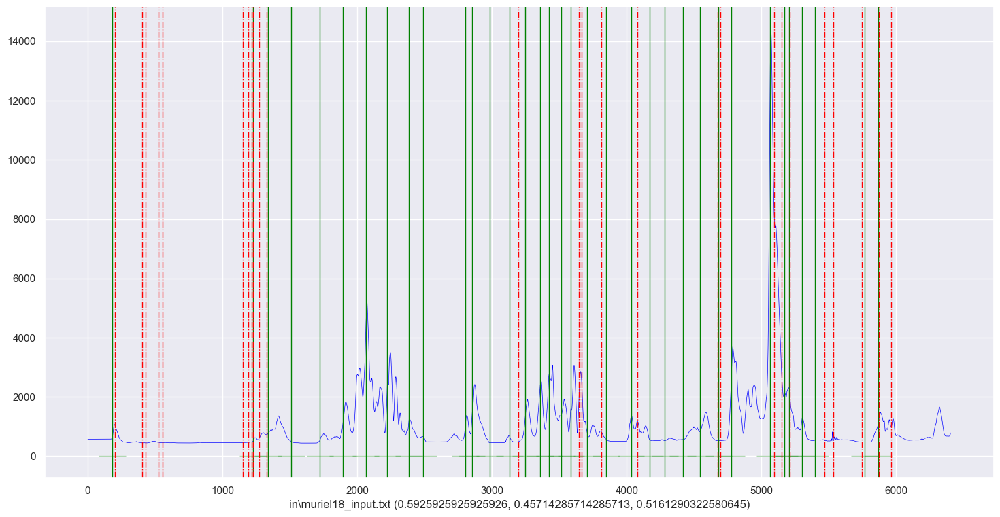

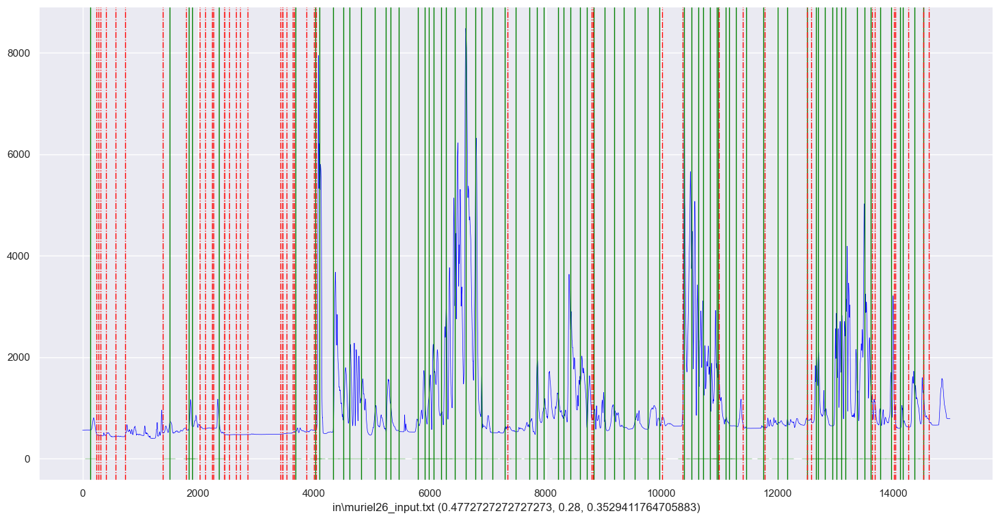

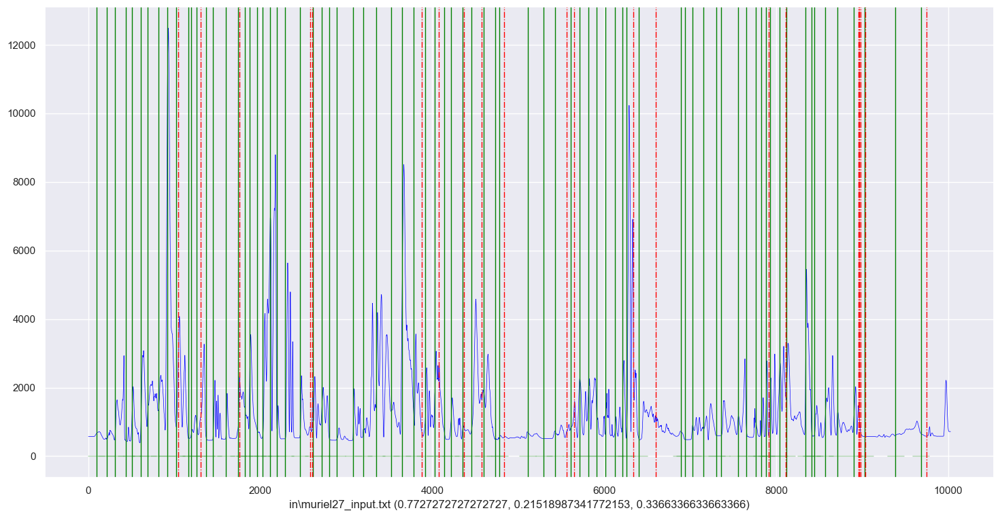

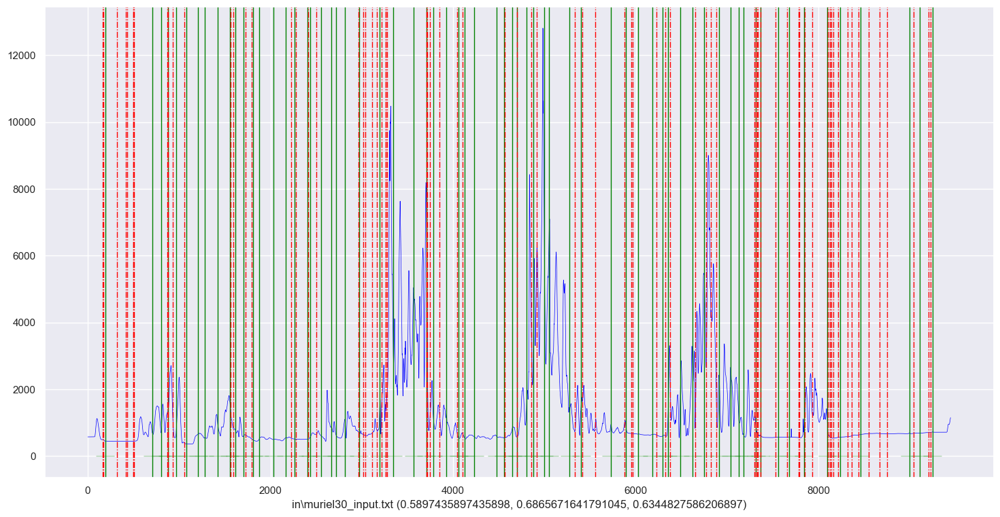

In [19]:
# acf, euclidean
for i in range(len(timeseries)):
    print(i)
    df=ReadAndPreProcess(timeseries[i])
    gt=LoadingGroundTruth(df,groundtruth[i])
    cp,eachcp,clasp=GetClasp(df,gt,0,window_size="acf", distance="euclidean_distance")
    PlotResult(df,gt,cp, timeseries[i], 100)
    Evaluate("CLASP",groundtruth[i],gt,timeseries[i],cp,df,100,"acf euclidean",timeseries[i])

0
f1margin: (0.24705882352941178, 0.65625, 0.358974358974359)
1
f1margin: (0.225, 0.5625, 0.3214285714285714)
2
f1margin: (0.12878787878787878, 1.0, 0.22818791946308722)
3
f1margin: (0.45714285714285713, 0.64, 0.5333333333333333)
4
f1margin: (0.3142857142857143, 0.5238095238095238, 0.39285714285714285)
5
f1margin: (0.3392857142857143, 0.7037037037037037, 0.4578313253012048)
6
f1margin: (0.4166666666666667, 0.38461538461538464, 0.4)
7
f1margin: (0.43478260869565216, 0.38461538461538464, 0.40816326530612246)
8
f1margin: (0.375, 0.2, 0.26086956521739135)
9
f1margin: (0.29411764705882354, 0.45454545454545453, 0.35714285714285715)
10
f1margin: (0.23636363636363636, 0.6190476190476191, 0.34210526315789475)
11
f1margin: (0.25, 0.3076923076923077, 0.27586206896551724)
12
f1margin: (0.1724137931034483, 0.5555555555555556, 0.26315789473684215)
13
f1margin: (0.46774193548387094, 0.7435897435897436, 0.5742574257425742)
14
f1margin: (0.10638297872340426, 0.8823529411764706, 0.18987341772151897)
15


C:\Users\loluc\AppData\Local\Temp\ipykernel_18008\8351913.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(18,9))


f1margin: (0.7352941176470589, 0.31645569620253167, 0.44247787610619477)
21
f1margin: (0.5760869565217391, 0.7910447761194029, 0.6666666666666666)


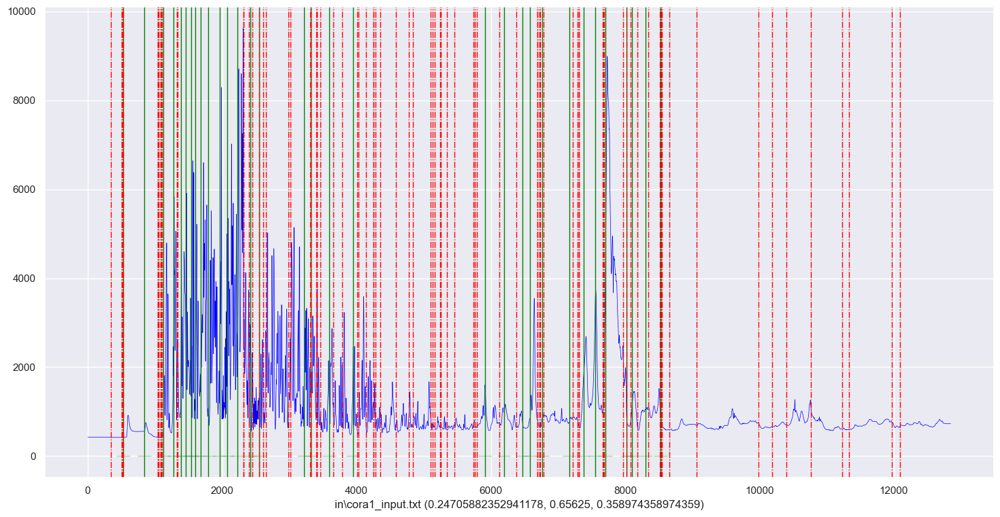

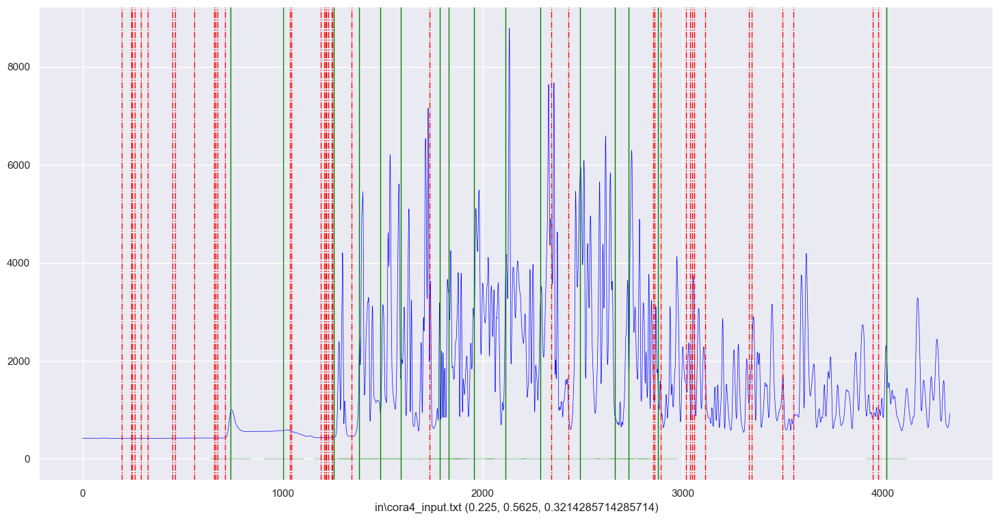

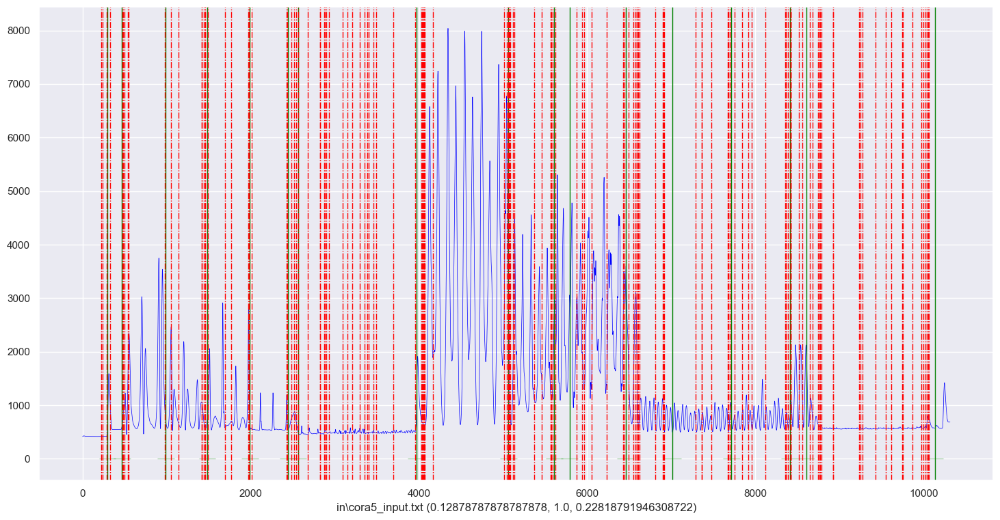

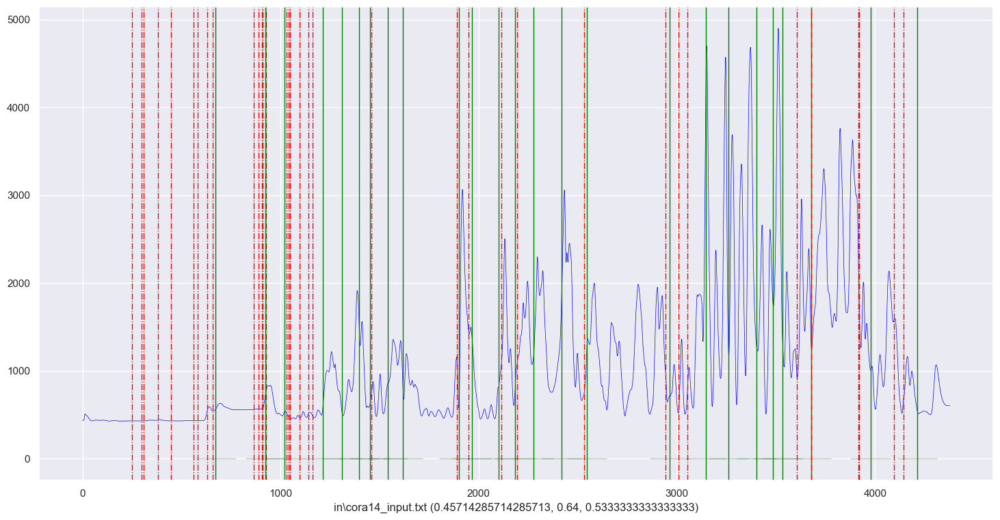

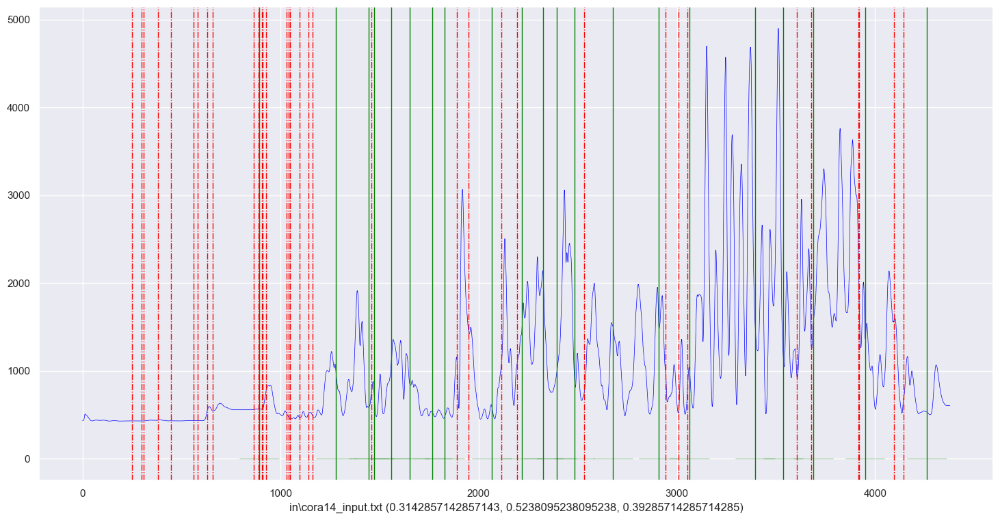

...

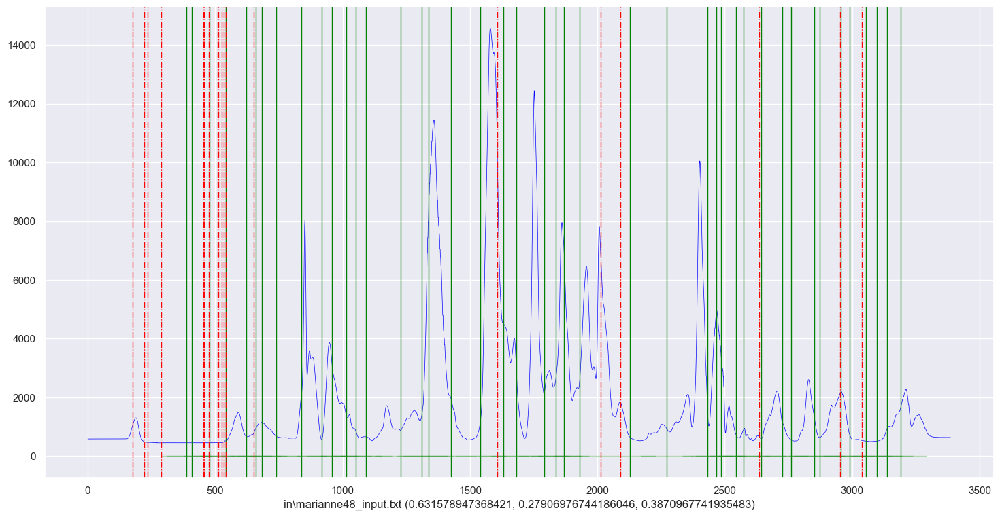

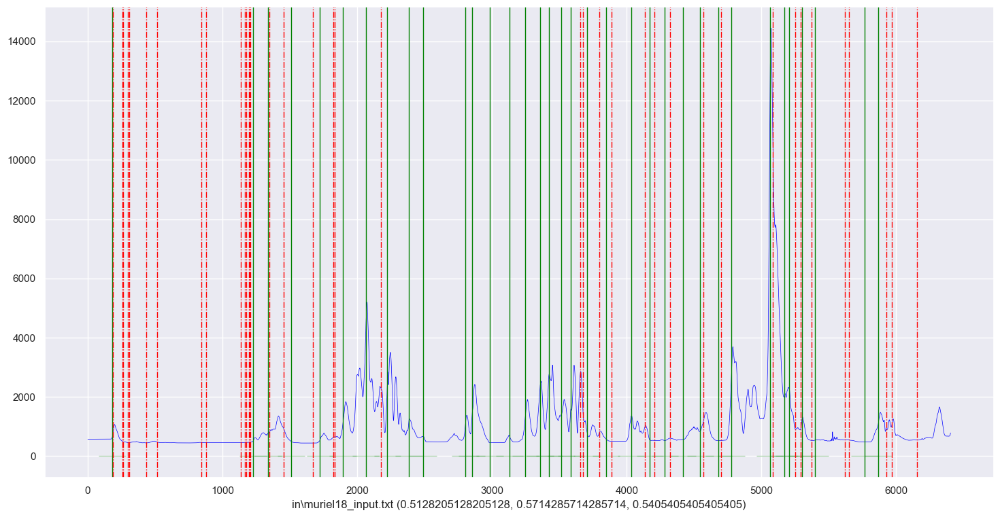

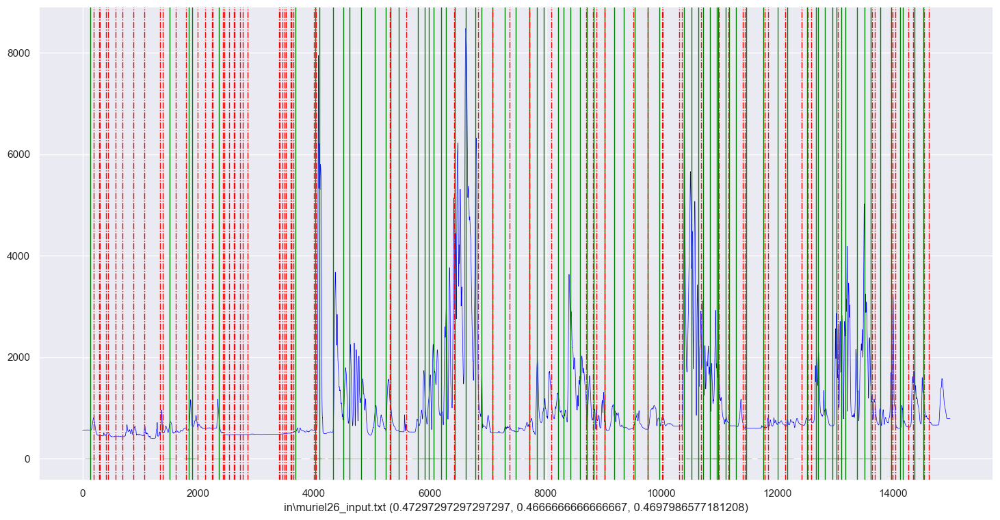

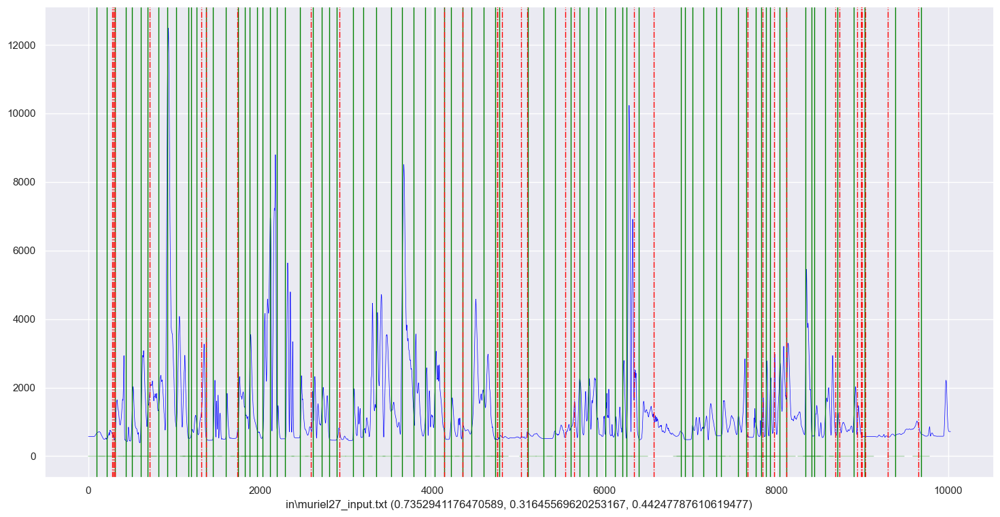

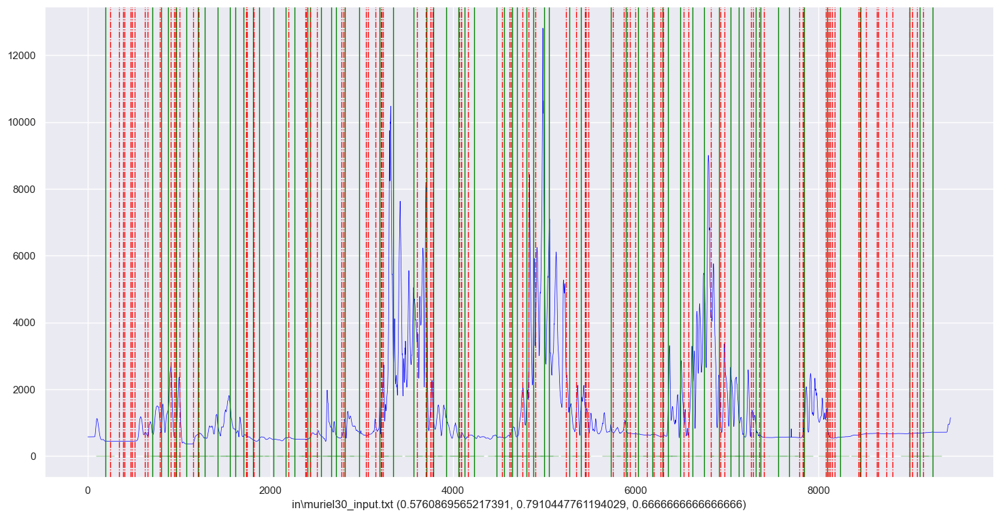

In [20]:
# suss, euclidean, 4
for i in range(len(timeseries)):
    print(i)
    df=ReadAndPreProcess(timeseries[i])
    gt=LoadingGroundTruth(df,groundtruth[i])
    cp,eachcp,clasp=GetClasp(df,gt,0,window_size="suss", distance="euclidean_distance", excl_radius=4)
    PlotResult(df,gt,cp, timeseries[i], 100)
    Evaluate("CLASP",groundtruth[i],gt,timeseries[i],cp,df,100,"suss euclidean 4 ",timeseries[i])

0
f1margin: (0.38461538461538464, 0.46875, 0.4225352112676056)
1
f1margin: (0.3181818181818182, 0.4375, 0.3684210526315789)
2
f1margin: (0.1619047619047619, 1.0, 0.2786885245901639)
3
f1margin: (0.625, 0.6, 0.6122448979591836)
4
f1margin: (0.3333333333333333, 0.38095238095238093, 0.35555555555555557)
5
f1margin: (0.4666666666666667, 0.5185185185185185, 0.4912280701754386)
6
f1margin: (0.6153846153846154, 0.3076923076923077, 0.4102564102564103)
7
f1margin: (1.0, 0.46153846153846156, 0.631578947368421)
8
f1margin: (0.7272727272727273, 0.17777777777777778, 0.2857142857142857)
9
f1margin: (0.47619047619047616, 0.45454545454545453, 0.46511627906976744)
10
f1margin: (0.625, 0.47619047619047616, 0.5405405405405405)
11


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (0.3333333333333333, 0.15384615384615385, 0.21052631578947367)
12
f1margin: (0.0, 0.0, 0)
13
f1margin: (0.47058823529411764, 0.20512820512820512, 0.28571428571428564)
14
f1margin: (0.15, 0.35294117647058826, 0.21052631578947367)
15


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (0.5714285714285714, 0.23529411764705882, 0.3333333333333333)
16
f1margin: (0.5, 0.47058823529411764, 0.48484848484848486)
17
f1margin: (0.875, 0.32558139534883723, 0.47457627118644063)
18
f1margin: (0.8571428571428571, 0.17142857142857143, 0.2857142857142857)
19
f1margin: (0.47619047619047616, 0.13333333333333333, 0.20833333333333334)
20


C:\Users\loluc\AppData\Local\Temp\ipykernel_18008\8351913.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(18,9))


f1margin: (0.9545454545454546, 0.26582278481012656, 0.41584158415841577)
21
f1margin: (0.8461538461538461, 0.16417910447761194, 0.275)


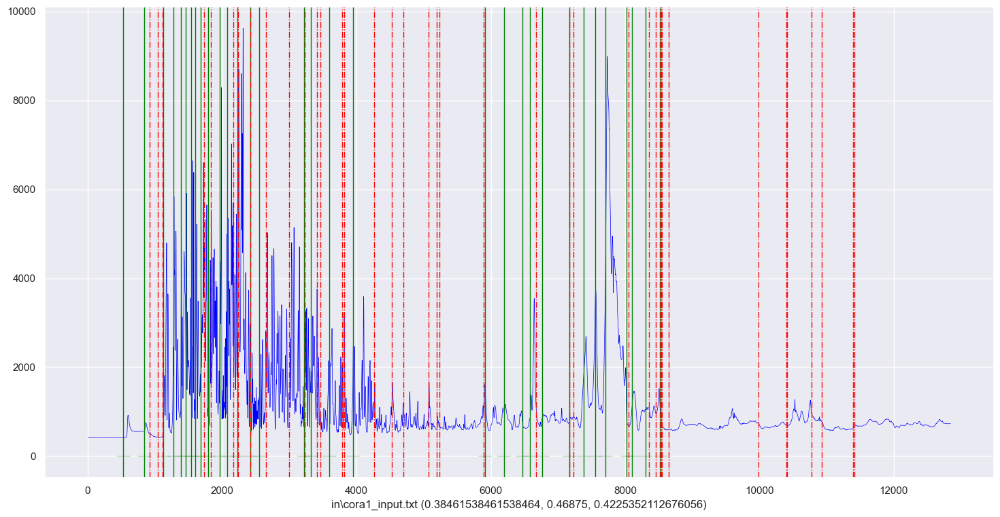

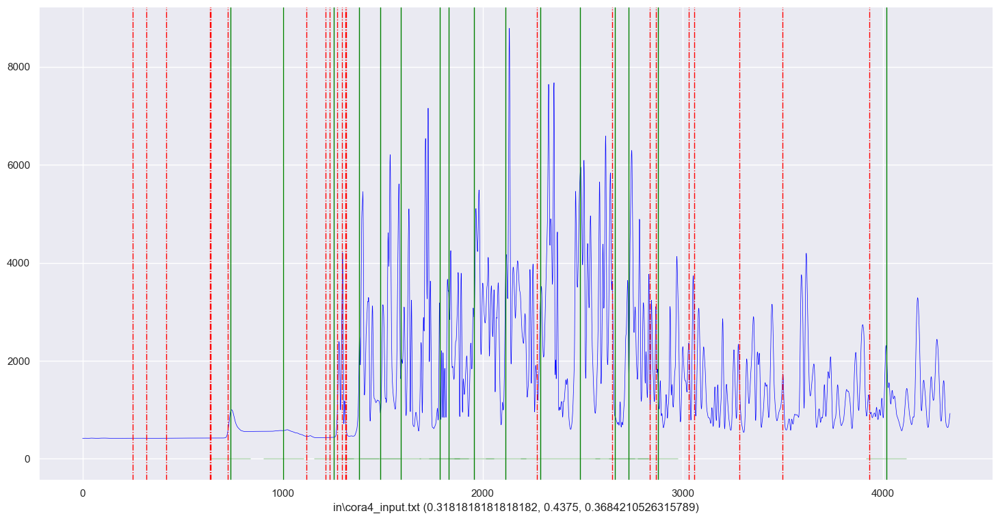

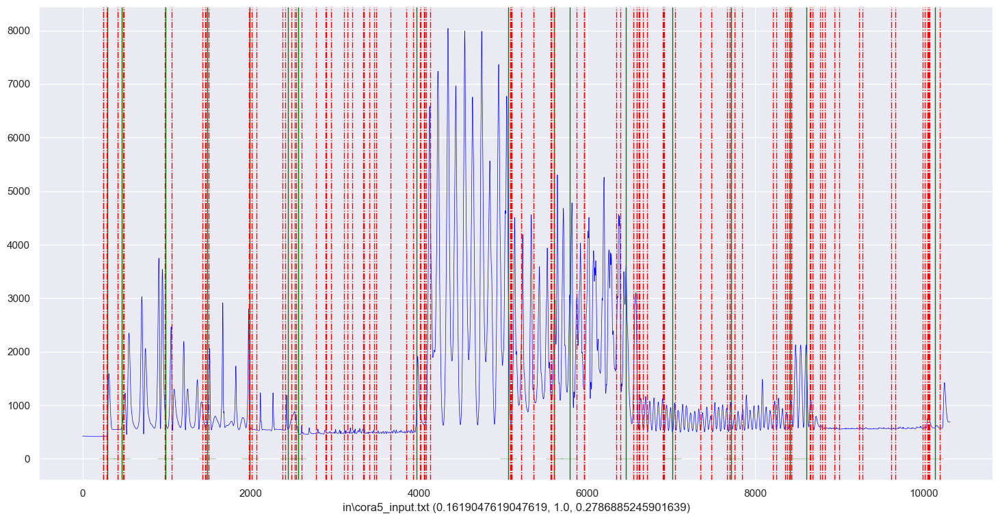

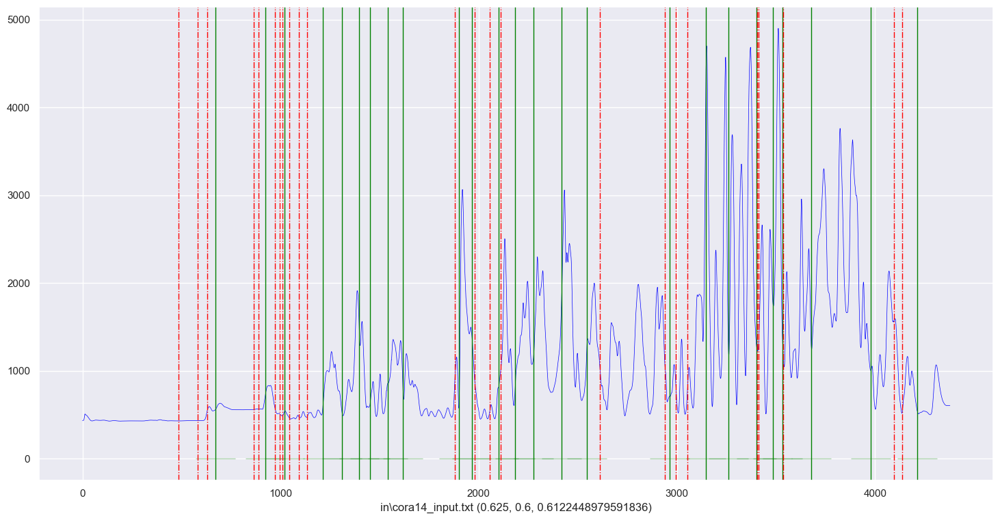

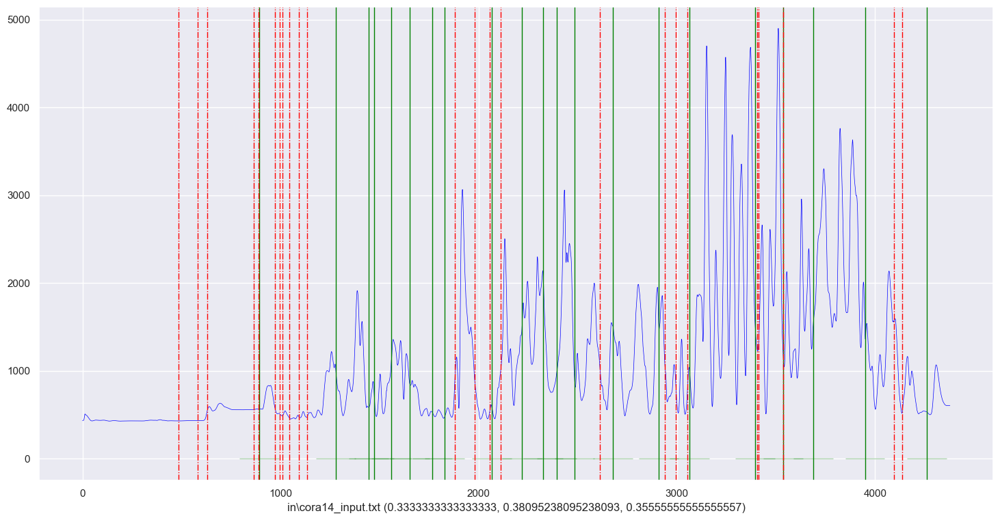

...

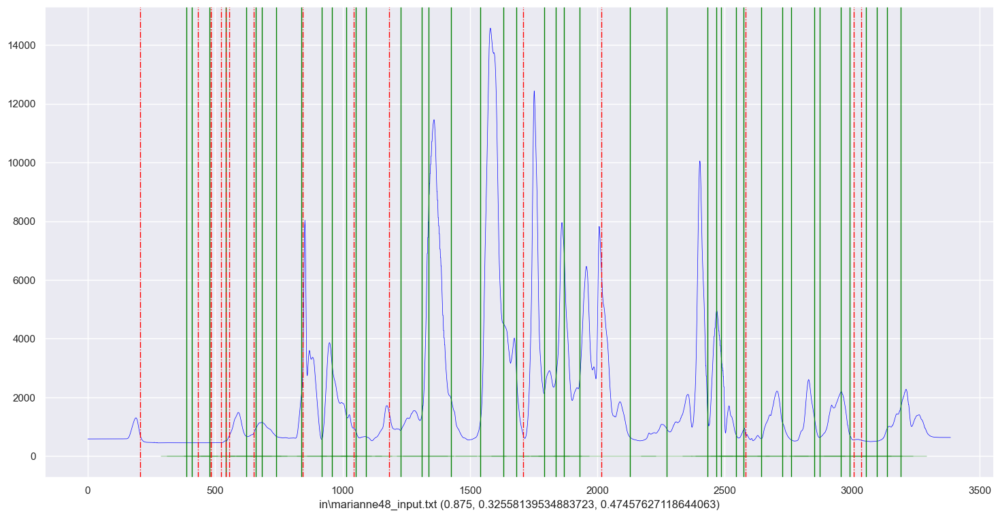

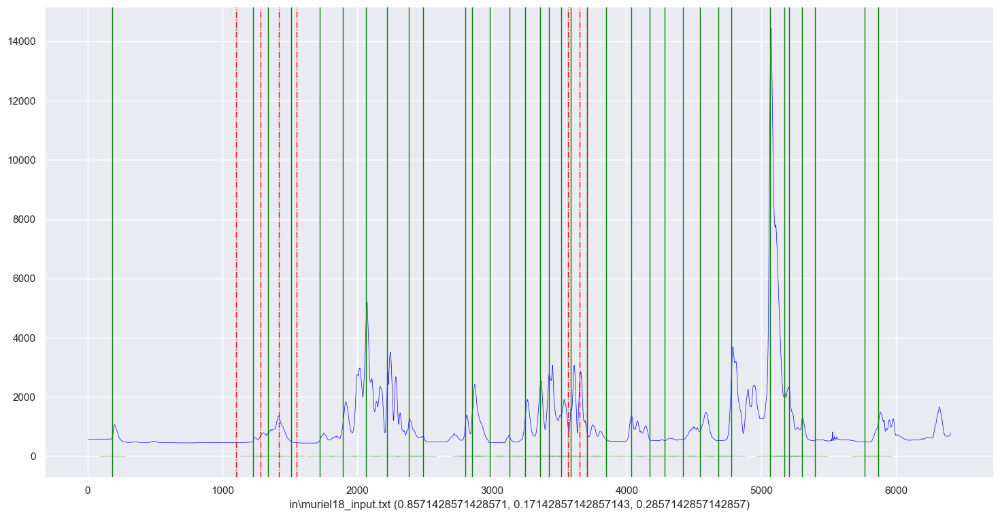

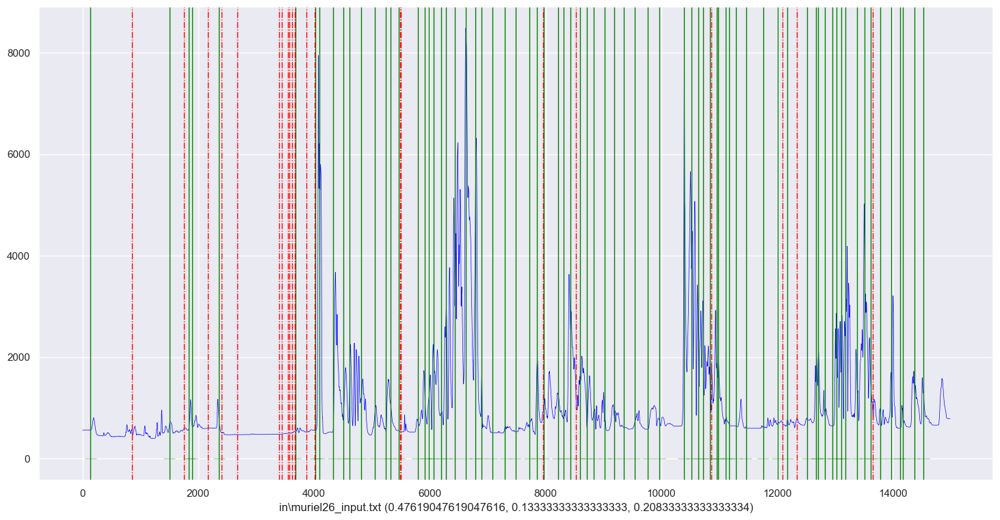

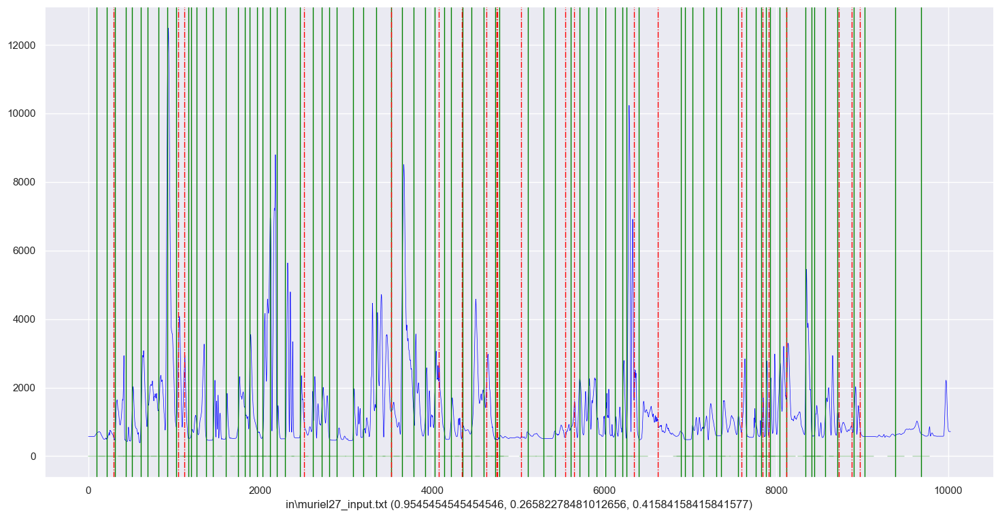

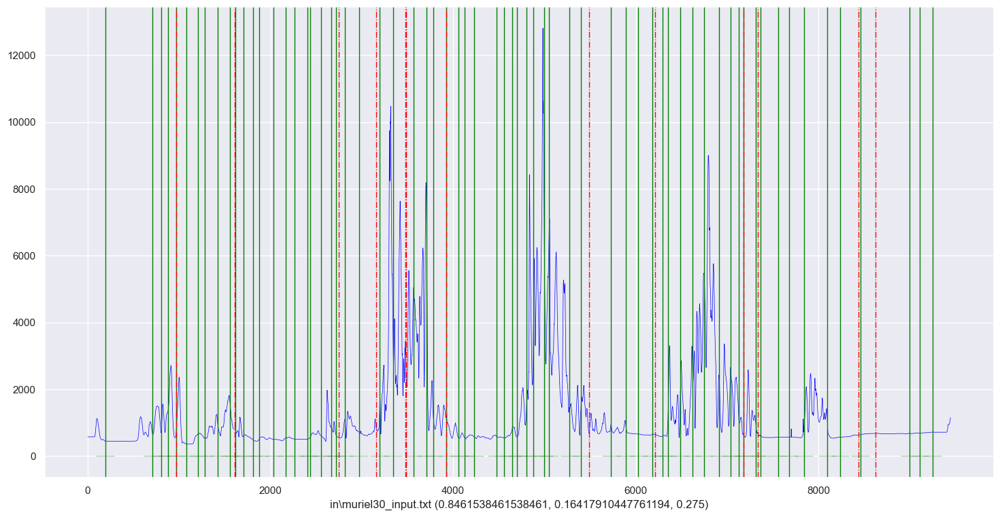

In [21]:
# fft, euclidean, 4
for i in range(len(timeseries)):
    print(i)
    df=ReadAndPreProcess(timeseries[i])
    gt=LoadingGroundTruth(df,groundtruth[i])
    cp,eachcp,clasp=GetClasp(df,gt,0,window_size="fft", distance="euclidean_distance", excl_radius=4)
    PlotResult(df,gt,cp, timeseries[i], 100)
    Evaluate("CLASP",groundtruth[i],gt,timeseries[i],cp,df,100,"fft euclidean 4 ",timeseries[i])

0
f1margin: (0.2361111111111111, 0.53125, 0.32692307692307687)
1
f1margin: (0.3333333333333333, 0.5625, 0.4186046511627907)
2
f1margin: (0.13821138211382114, 1.0, 0.24285714285714285)
3
f1margin: (0.5357142857142857, 0.6, 0.5660377358490566)
4
f1margin: (0.39285714285714285, 0.5238095238095238, 0.4489795918367347)
5
f1margin: (0.42857142857142855, 0.4444444444444444, 0.43636363636363634)
6
f1margin: (0.6666666666666666, 0.5384615384615384, 0.5957446808510638)
7


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (0.7142857142857143, 0.38461538461538464, 0.5)
8
f1margin: (1.0, 0.2222222222222222, 0.3636363636363636)
9
f1margin: (0.30303030303030304, 0.45454545454545453, 0.36363636363636365)
10
f1margin: (0.2978723404255319, 0.6666666666666666, 0.4117647058823529)
11
f1margin: (0.5, 0.3076923076923077, 0.380952380952381)
12


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (0.3125, 0.5555555555555556, 0.39999999999999997)
13


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\window_size.py:213: UserWarning: Could not find any autocorrelation peaks. Using window_size=10.
  warnings.warn(f"Could not find any autocorrelation peaks. Using window_size={lbound}.")
C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\scipy\stats\_stats_py.py:9205: RuntimeWarning: invalid value encountered in scalar divide
  z = (s - expected) / np.sqrt(n1*n2*(n1+n2+1)/12.0)


f1margin: (0.2923076923076923, 0.9743589743589743, 0.44970414201183434)
14
f1margin: (0.10135135135135136, 0.8823529411764706, 0.18181818181818185)
15


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (0.8333333333333334, 0.29411764705882354, 0.4347826086956522)
16


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (0.47058823529411764, 0.47058823529411764, 0.47058823529411764)
17


C:\Users\loluc\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\claspy\segmentation.py:212: UserWarning: Time series must at least have 2*min_seg_size data points for segmentation. Try setting a smaller window size.
  warnings.warn(


f1margin: (0.9411764705882353, 0.37209302325581395, 0.5333333333333333)
18
f1margin: (0.5161290322580645, 0.45714285714285713, 0.4848484848484849)
19
f1margin: (0.46, 0.30666666666666664, 0.36800000000000005)
20


C:\Users\loluc\AppData\Local\Temp\ipykernel_18008\8351913.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(18,9))


f1margin: (0.7142857142857143, 0.189873417721519, 0.30000000000000004)
21
f1margin: (0.5340909090909091, 0.7014925373134329, 0.6064516129032257)


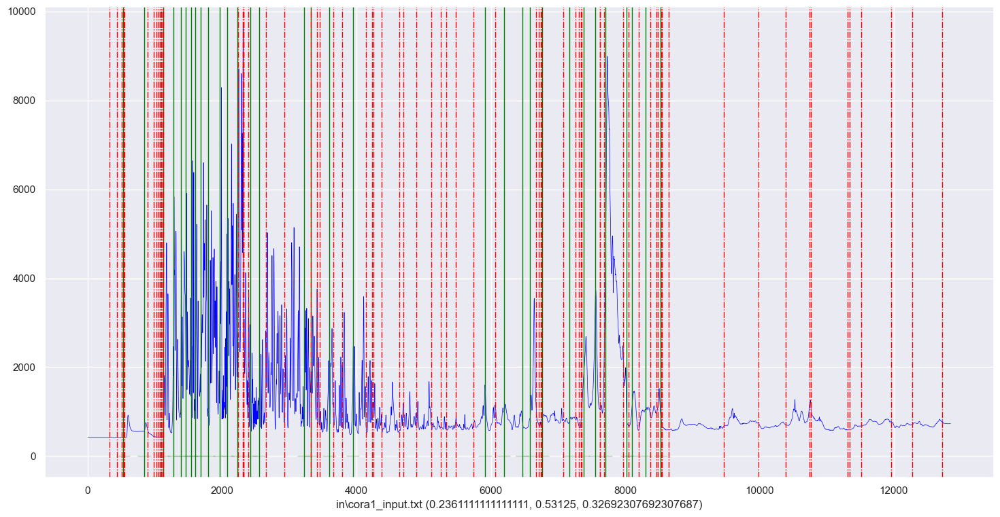

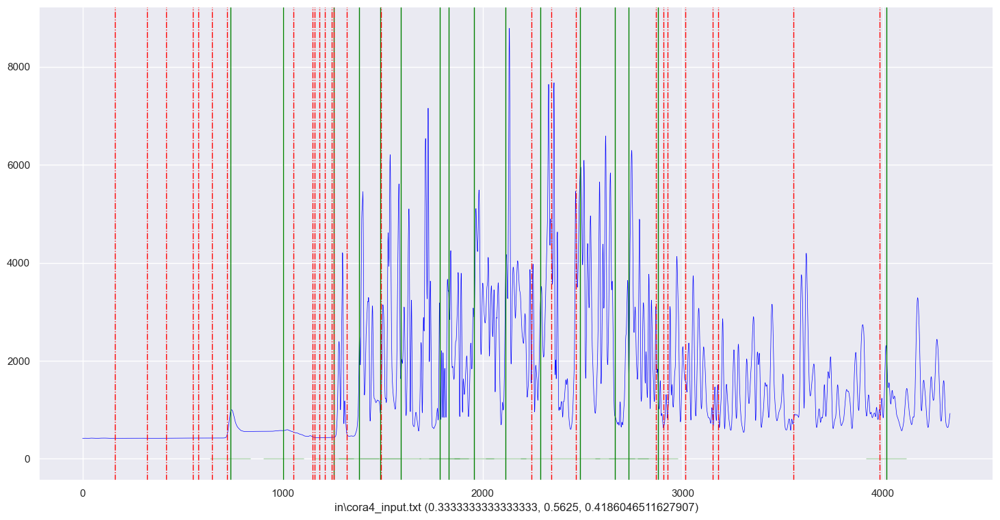

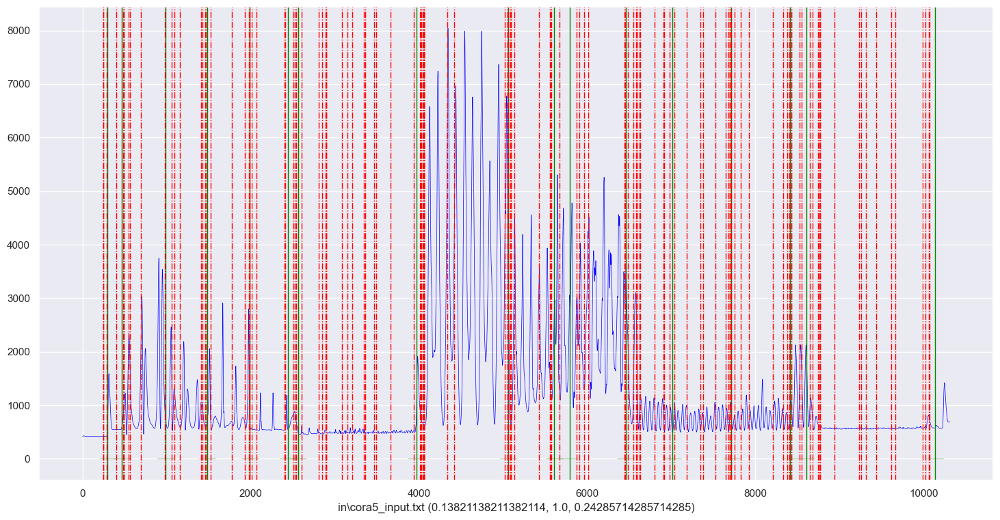

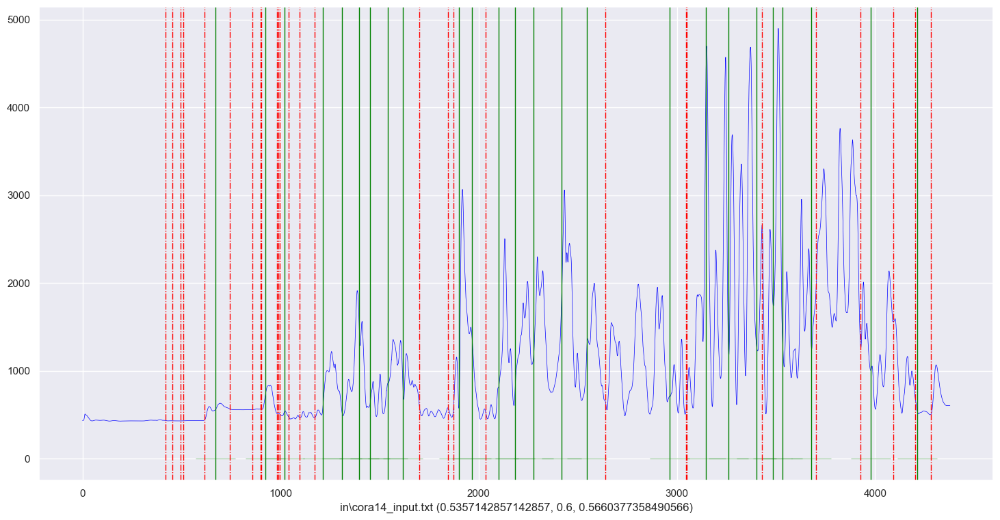

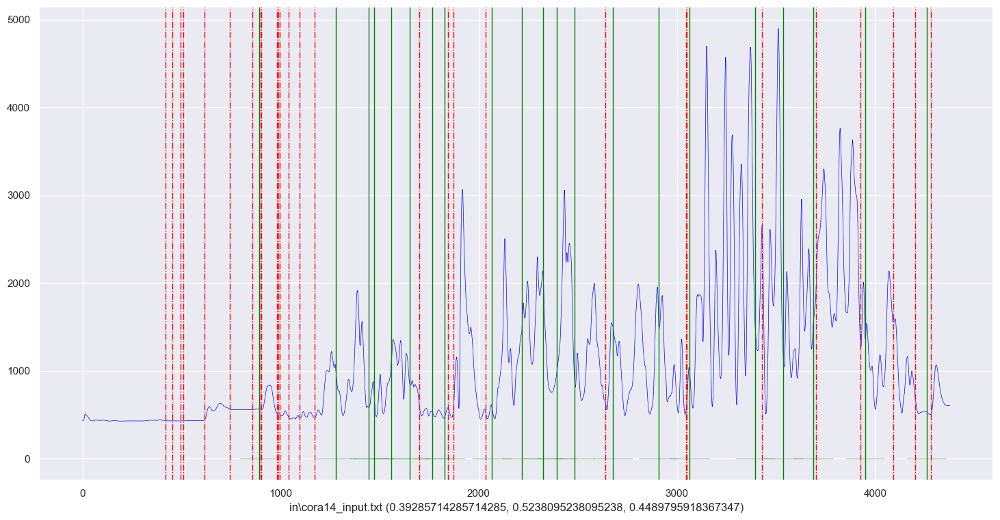

...

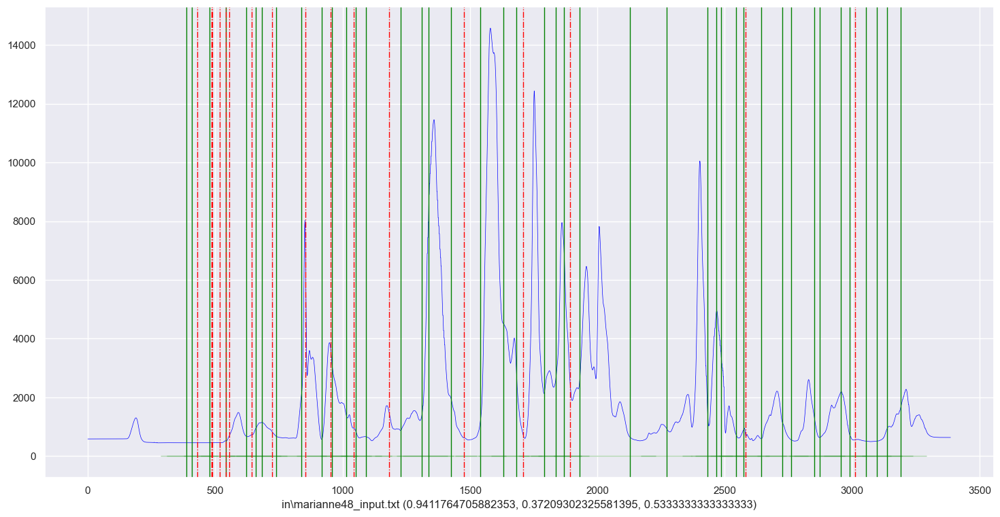

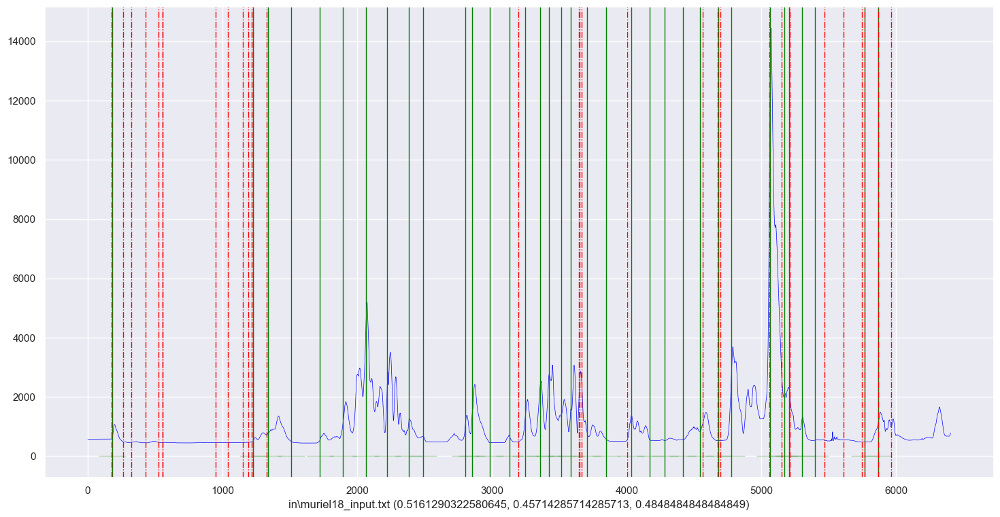

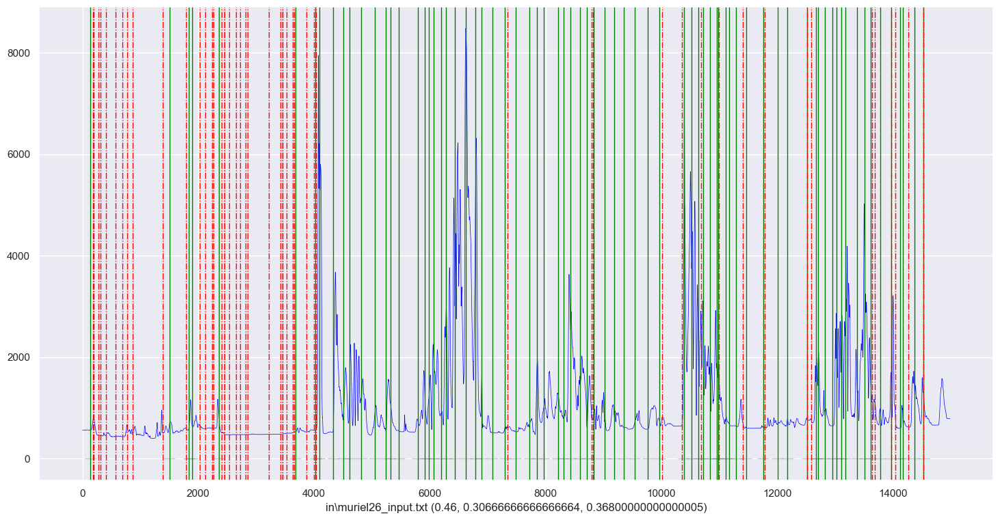

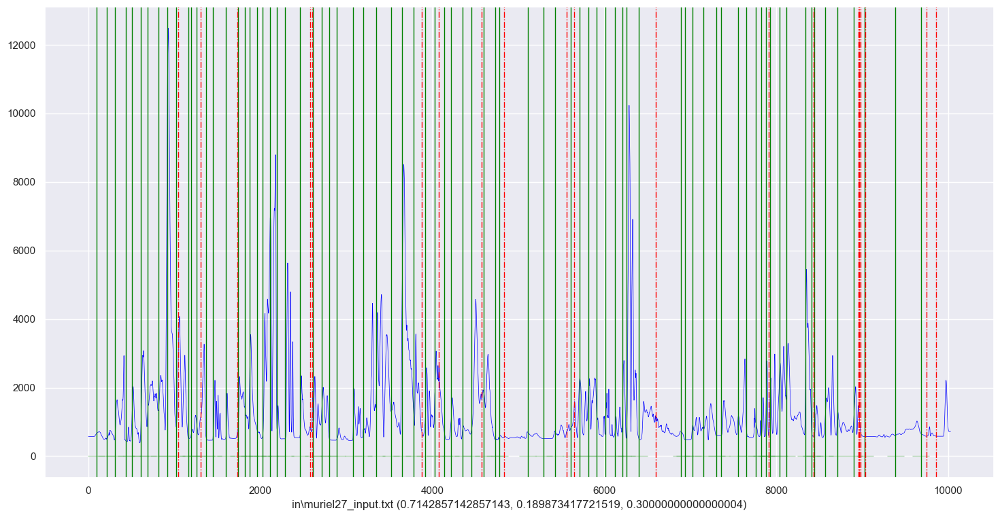

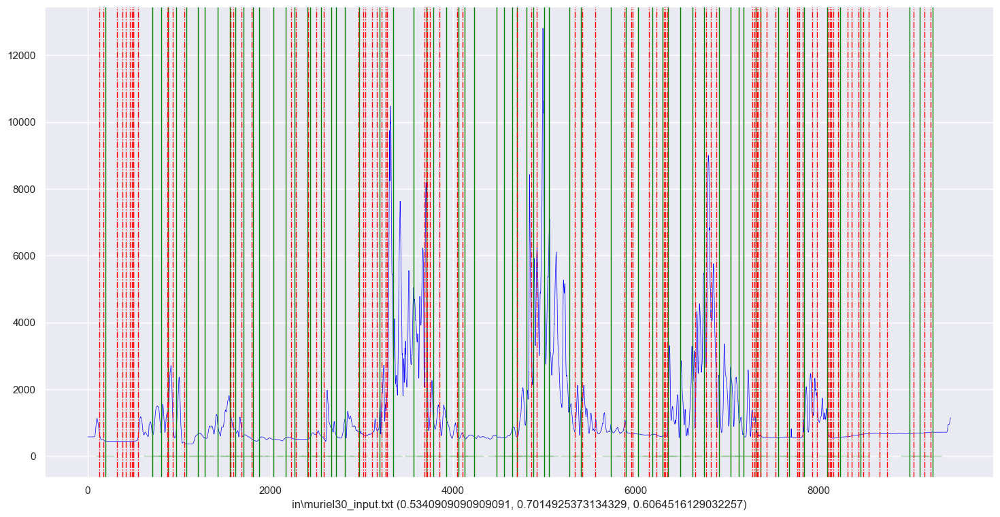

In [22]:
# acf, euclidean, 4
for i in range(len(timeseries)):
    print(i)
    df=ReadAndPreProcess(timeseries[i])
    gt=LoadingGroundTruth(df,groundtruth[i])
    cp,eachcp,clasp=GetClasp(df,gt,0,window_size="acf", distance="euclidean_distance", excl_radius=4)
    PlotResult(df,gt,cp, timeseries[i], 100)
    Evaluate("CLASP",groundtruth[i],gt,timeseries[i],cp,df,100,"acf euclidean 4 ",timeseries[i])